In [1]:
#LOADING IMPORTANT LIBRARIES

import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import numpy as np
np.set_printoptions(threshold=np.inf)
import matplotlib.pyplot as plt,seaborn as sns
%matplotlib inline

This case study aims to identify patterns which indicate if a client has difficulty paying their instalments which may be used for taking actions such as denying the loan, reducing the amount of loan, lending (to risky applicants) at a higher interest rate, etc. This will ensure that the consumers capable of repaying the loan are not rejected. Identification of such applicants using EDA is the aim of this case study.

 

In other words, the company wants to understand the driving factors (or driver variables) behind loan default, i.e. the variables which are strong indicators of default.  The company can utilise this knowledge for its portfolio and risk assessment.

# PREVIOUS DATA

In [295]:
# lOADING THE DATASET 

data_previous=pd.read_csv("C:/Users/lenovo/Downloads/previous_application.csv")

In [310]:
data_previous.shape

(1670214, 37)

In [311]:
data_previous.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [312]:
data_previous.isnull().sum()

SK_ID_PREV                           0
SK_ID_CURR                           0
NAME_CONTRACT_TYPE                   0
AMT_ANNUITY                     372235
AMT_APPLICATION                      0
AMT_CREDIT                           1
AMT_DOWN_PAYMENT                895844
AMT_GOODS_PRICE                 385515
WEEKDAY_APPR_PROCESS_START           0
HOUR_APPR_PROCESS_START              0
FLAG_LAST_APPL_PER_CONTRACT          0
NFLAG_LAST_APPL_IN_DAY               0
RATE_DOWN_PAYMENT               895844
RATE_INTEREST_PRIMARY          1664263
RATE_INTEREST_PRIVILEGED       1664263
NAME_CASH_LOAN_PURPOSE               0
NAME_CONTRACT_STATUS                 0
DAYS_DECISION                        0
NAME_PAYMENT_TYPE                    0
CODE_REJECT_REASON                   0
NAME_TYPE_SUITE                 820405
NAME_CLIENT_TYPE                     0
NAME_GOODS_CATEGORY                  0
NAME_PORTFOLIO                       0
NAME_PRODUCT_TYPE                    0
CHANNEL_TYPE             

In [313]:
data_previous.isnull().mean()* 100

SK_ID_PREV                      0.000000
SK_ID_CURR                      0.000000
NAME_CONTRACT_TYPE              0.000000
AMT_ANNUITY                    22.286665
AMT_APPLICATION                 0.000000
AMT_CREDIT                      0.000060
AMT_DOWN_PAYMENT               53.636480
AMT_GOODS_PRICE                23.081773
WEEKDAY_APPR_PROCESS_START      0.000000
HOUR_APPR_PROCESS_START         0.000000
FLAG_LAST_APPL_PER_CONTRACT     0.000000
NFLAG_LAST_APPL_IN_DAY          0.000000
RATE_DOWN_PAYMENT              53.636480
RATE_INTEREST_PRIMARY          99.643698
RATE_INTEREST_PRIVILEGED       99.643698
NAME_CASH_LOAN_PURPOSE          0.000000
NAME_CONTRACT_STATUS            0.000000
DAYS_DECISION                   0.000000
NAME_PAYMENT_TYPE               0.000000
CODE_REJECT_REASON              0.000000
NAME_TYPE_SUITE                49.119754
NAME_CLIENT_TYPE                0.000000
NAME_GOODS_CATEGORY             0.000000
NAME_PORTFOLIO                  0.000000
NAME_PRODUCT_TYP

In [314]:
data_previous.shape

(1670214, 37)

In [315]:
data_previous.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


# Missing value and outliers handling

#### 2 columns have 99% missing values.Lets check the values of the columns

In [316]:
data_previous["RATE_INTEREST_PRIMARY"].head(10)

0    0.182832
1         NaN
2         NaN
3         NaN
4         NaN
5         NaN
6         NaN
7         NaN
8         NaN
9         NaN
Name: RATE_INTEREST_PRIMARY, dtype: float64

In [317]:
data_previous["RATE_INTEREST_PRIVILEGED"].head(10)

0    0.867336
1         NaN
2         NaN
3         NaN
4         NaN
5         NaN
6         NaN
7         NaN
8         NaN
9         NaN
Name: RATE_INTEREST_PRIVILEGED, dtype: float64

#### Both columns have NaN values.so we dont need it in future.Because its almost 100% missing values

In [318]:
data_previous.drop(["RATE_INTEREST_PRIVILEGED","RATE_INTEREST_PRIMARY"],inplace=True,axis=1)

In [319]:
# Rechecking the shape of the dataset

data_previous.shape

(1670214, 35)

In [320]:
data_previous.isnull().mean()* 100

SK_ID_PREV                      0.000000
SK_ID_CURR                      0.000000
NAME_CONTRACT_TYPE              0.000000
AMT_ANNUITY                    22.286665
AMT_APPLICATION                 0.000000
AMT_CREDIT                      0.000060
AMT_DOWN_PAYMENT               53.636480
AMT_GOODS_PRICE                23.081773
WEEKDAY_APPR_PROCESS_START      0.000000
HOUR_APPR_PROCESS_START         0.000000
FLAG_LAST_APPL_PER_CONTRACT     0.000000
NFLAG_LAST_APPL_IN_DAY          0.000000
RATE_DOWN_PAYMENT              53.636480
NAME_CASH_LOAN_PURPOSE          0.000000
NAME_CONTRACT_STATUS            0.000000
DAYS_DECISION                   0.000000
NAME_PAYMENT_TYPE               0.000000
CODE_REJECT_REASON              0.000000
NAME_TYPE_SUITE                49.119754
NAME_CLIENT_TYPE                0.000000
NAME_GOODS_CATEGORY             0.000000
NAME_PORTFOLIO                  0.000000
NAME_PRODUCT_TYPE               0.000000
CHANNEL_TYPE                    0.000000
SELLERPLACE_AREA

#### Checking AMT_ANNUITY

In [321]:
pd.set_option("max_rows", None)

In [322]:
#pd.set_option('display.max_columns', None)
data_previous.AMT_ANNUITY.isnull().sum()

372235

In [323]:
data_previous.AMT_ANNUITY.dtype

dtype('float64')

In [324]:
data_previous.AMT_ANNUITY.describe()

count    1.297979e+06
mean     1.595512e+04
std      1.478214e+04
min      0.000000e+00
25%      6.321780e+03
50%      1.125000e+04
75%      2.065842e+04
max      4.180581e+05
Name: AMT_ANNUITY, dtype: float64

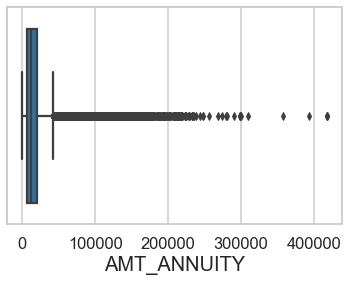

In [325]:
sns.boxplot(data_previous.AMT_ANNUITY)
plt.show()

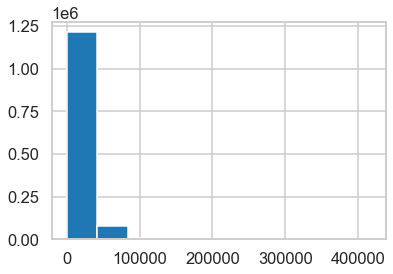

In [326]:
plt.hist(data_previous.AMT_ANNUITY)
plt.show()

#### values are seems to be continous 

In [327]:
data_previous.AMT_ANNUITY.isnull().sum()

372235

In [328]:
data_previous.AMT_ANNUITY.mode()

0    2250.0
dtype: float64

In [329]:
data_previous.AMT_ANNUITY.mean()

15955.120659450406

In [330]:
data_previous.AMT_ANNUITY.median()

11250.0

#### AMT_ANNUITY columns have  lots of missing values and we can replace missin values with median value because most of the values lies in that range

In [331]:
data_previous.AMT_ANNUITY.fillna(data_previous.AMT_ANNUITY.median(),inplace=True)

In [332]:
data_previous.AMT_ANNUITY.isnull().sum()  # rechecking median values are perfectly distributed

0

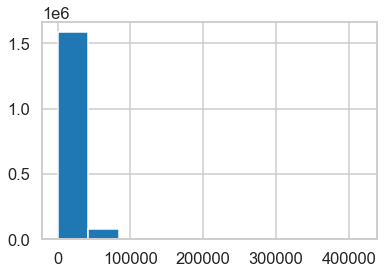

In [333]:
plt.hist(data_previous.AMT_ANNUITY)
plt.show()

#### Checking AMT_DOWN_PAYMENT

In [334]:
data_previous.AMT_DOWN_PAYMENT.value_counts()

 0.000          369854
 4500.000        21241
 9000.000        14747
 13500.000        9655
 22500.000        8165
 6750.000         7709
 2250.000         6241
 18000.000        4526
 45000.000        4059
 2700.000         3362
 3150.000         3086
 11250.000        2937
 3600.000         2678
 5400.000         2220
 27000.000        2148
 4950.000         1722
 5850.000         1688
 1800.000         1657
 4050.000         1614
 31500.000        1479
 36000.000        1300
 6300.000         1268
 15750.000        1243
 2475.000         1235
 2925.000         1137
 7200.000         1126
 3375.000          988
 8100.000          983
 67500.000         973
 7650.000          962
 0.900             928
 2025.000          803
 3825.000          791
 2245.500          780
 9900.000          756
 90000.000         756
 3145.500          710
 2695.500          701
 20250.000         671
 3595.500          670
 4495.500          655
 9450.000          643
 1575.000          637
 2.250     

In [335]:
data_previous.AMT_DOWN_PAYMENT.dtype

dtype('float64')

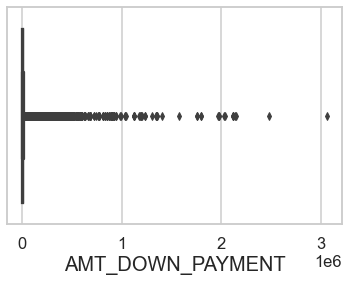

In [336]:
sns.boxplot(data_previous.AMT_DOWN_PAYMENT)
plt.show()

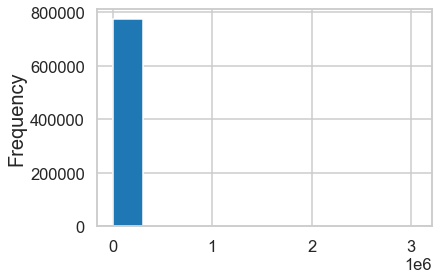

In [337]:
data_previous.AMT_DOWN_PAYMENT.plot.hist()
plt.show()

In [338]:
data_previous.AMT_DOWN_PAYMENT.describe()

count    7.743700e+05
mean     6.697402e+03
std      2.092150e+04
min     -9.000000e-01
25%      0.000000e+00
50%      1.638000e+03
75%      7.740000e+03
max      3.060045e+06
Name: AMT_DOWN_PAYMENT, dtype: float64

In [339]:
data_previous.AMT_DOWN_PAYMENT.isnull().sum()

895844

#### AMT_DOWN_PAYMENT have more than 50% of data missing.Its better to remove the column

In [340]:
data_previous.drop(["AMT_DOWN_PAYMENT"],inplace=True,axis=1)

#### Checking NAME_TYPE_SUITE

In [341]:
data_previous.NAME_TYPE_SUITE.value_counts()

Unaccompanied      508970
Family             213263
Spouse, partner     67069
Children            31566
Other_B             17624
Other_A              9077
Group of people      2240
Name: NAME_TYPE_SUITE, dtype: int64

#### we can drop this column becuase it will not make reflect the further analysis

In [342]:
data_previous.drop(["NAME_TYPE_SUITE"],inplace=True,axis=1)

In [343]:
data_previous.isnull().mean()* 100

SK_ID_PREV                      0.000000
SK_ID_CURR                      0.000000
NAME_CONTRACT_TYPE              0.000000
AMT_ANNUITY                     0.000000
AMT_APPLICATION                 0.000000
AMT_CREDIT                      0.000060
AMT_GOODS_PRICE                23.081773
WEEKDAY_APPR_PROCESS_START      0.000000
HOUR_APPR_PROCESS_START         0.000000
FLAG_LAST_APPL_PER_CONTRACT     0.000000
NFLAG_LAST_APPL_IN_DAY          0.000000
RATE_DOWN_PAYMENT              53.636480
NAME_CASH_LOAN_PURPOSE          0.000000
NAME_CONTRACT_STATUS            0.000000
DAYS_DECISION                   0.000000
NAME_PAYMENT_TYPE               0.000000
CODE_REJECT_REASON              0.000000
NAME_CLIENT_TYPE                0.000000
NAME_GOODS_CATEGORY             0.000000
NAME_PORTFOLIO                  0.000000
NAME_PRODUCT_TYPE               0.000000
CHANNEL_TYPE                    0.000000
SELLERPLACE_AREA                0.000000
NAME_SELLER_INDUSTRY            0.000000
CNT_PAYMENT     

#### Checking AMT_GOODS_PRICE  column

In [344]:
pd.set_option("max_rows", None)
data_previous.AMT_GOODS_PRICE.value_counts(normalize=True)*100

45000.000      3.723129
225000.000     3.389821
135000.000     3.165411
450000.000     3.029970
90000.000      2.285905
180000.000     1.925432
270000.000     1.600920
675000.000     1.575077
67500.000      1.312136
900000.000     1.212113
112500.000     1.118783
315000.000     0.927844
229500.000     0.837239
337500.000     0.820192
360000.000     0.800654
157500.000     0.795517
1350000.000    0.656496
202500.000     0.617810
247500.000     0.557407
454500.000     0.547910
1129500.000    0.539270
0.000          0.534678
540000.000     0.532576
1125000.000    0.497393
405000.000     0.457072
765000.000     0.398848
585000.000     0.371293
292500.000     0.294777
495000.000     0.291819
810000.000     0.271425
630000.000     0.223554
720000.000     0.214603
31455.000      0.199969
22455.000      0.198101
1800000.000    0.197011
382500.000     0.193119
44955.000      0.182922
26955.000      0.181599
472500.000     0.179108
184500.000     0.173192
62955.000      0.173114
35955.000      0

In [345]:
data_previous.AMT_GOODS_PRICE.describe()

count    1.284699e+06
mean     2.278473e+05
std      3.153966e+05
min      0.000000e+00
25%      5.084100e+04
50%      1.123200e+05
75%      2.340000e+05
max      6.905160e+06
Name: AMT_GOODS_PRICE, dtype: float64

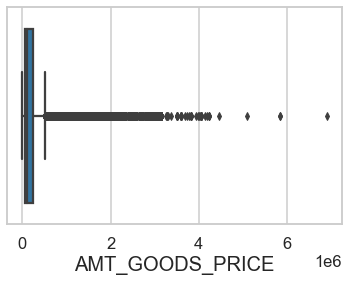

In [346]:
sns.boxplot(data_previous.AMT_GOODS_PRICE)
plt.show()


In [347]:
data_previous.AMT_GOODS_PRICE.mean()

227847.27928334344

In [348]:
data_previous.AMT_GOODS_PRICE.median()

112320.0

In [349]:
data_previous.AMT_GOODS_PRICE.isnull().sum()

385515

In [350]:
data_previous.AMT_GOODS_PRICE.quantile(0.75)

234000.0

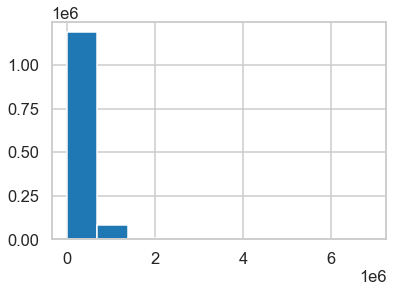

In [351]:
plt.hist(data_previous.AMT_GOODS_PRICE)
plt.show()

#### we can replace the mising values in AMT_GOODS_PRICE with median value.because there are outliers butit seems to be continous.no need to remove the column.And also median is the better value to be replaced if outliers are there

In [352]:
data_previous.AMT_GOODS_PRICE.fillna(data_previous.AMT_GOODS_PRICE.isnull().median(),inplace=True)

In [353]:
data_previous.AMT_GOODS_PRICE.isnull().sum()

0

In [354]:
data_previous.isnull().mean()* 100

SK_ID_PREV                      0.000000
SK_ID_CURR                      0.000000
NAME_CONTRACT_TYPE              0.000000
AMT_ANNUITY                     0.000000
AMT_APPLICATION                 0.000000
AMT_CREDIT                      0.000060
AMT_GOODS_PRICE                 0.000000
WEEKDAY_APPR_PROCESS_START      0.000000
HOUR_APPR_PROCESS_START         0.000000
FLAG_LAST_APPL_PER_CONTRACT     0.000000
NFLAG_LAST_APPL_IN_DAY          0.000000
RATE_DOWN_PAYMENT              53.636480
NAME_CASH_LOAN_PURPOSE          0.000000
NAME_CONTRACT_STATUS            0.000000
DAYS_DECISION                   0.000000
NAME_PAYMENT_TYPE               0.000000
CODE_REJECT_REASON              0.000000
NAME_CLIENT_TYPE                0.000000
NAME_GOODS_CATEGORY             0.000000
NAME_PORTFOLIO                  0.000000
NAME_PRODUCT_TYPE               0.000000
CHANNEL_TYPE                    0.000000
SELLERPLACE_AREA                0.000000
NAME_SELLER_INDUSTRY            0.000000
CNT_PAYMENT     

#### Checking RATE_DOWN_PAYMENT.This column has more than 50% null values.So as we did earlier we are droping this column 

In [355]:
data_previous.drop(["RATE_DOWN_PAYMENT"],inplace=True,axis=1)

####  Checking CNT_PAYMENT column

In [356]:
data_previous.CNT_PAYMENT.value_counts()

12.0    323049
6.0     190461
0.0     144985
10.0    141851
24.0    137764
18.0     77430
36.0     72583
60.0     53600
48.0     47316
8.0      30349
4.0      26924
30.0     16924
14.0      8253
42.0      7136
16.0      5710
5.0       3957
54.0      2104
20.0      1805
7.0       1434
9.0       1236
3.0       1100
15.0       904
11.0       669
72.0       139
13.0        51
17.0        48
84.0        45
22.0        37
23.0        27
26.0        13
35.0        11
66.0        10
28.0         8
29.0         8
32.0         6
19.0         6
34.0         4
59.0         4
41.0         3
47.0         3
45.0         3
21.0         3
44.0         2
39.0         2
46.0         2
38.0         2
33.0         1
40.0         1
53.0         1
Name: CNT_PAYMENT, dtype: int64

In [357]:
data_previous.CNT_PAYMENT.dtype

dtype('float64')

In [358]:
data_previous.CNT_PAYMENT.describe()

count    1.297984e+06
mean     1.605408e+01
std      1.456729e+01
min      0.000000e+00
25%      6.000000e+00
50%      1.200000e+01
75%      2.400000e+01
max      8.400000e+01
Name: CNT_PAYMENT, dtype: float64

In [359]:
data_previous.CNT_PAYMENT.mean()

16.0540815603274

In [360]:
data_previous.CNT_PAYMENT.median()

12.0

In [361]:
data_previous.CNT_PAYMENT.mode()

0    12.0
dtype: float64

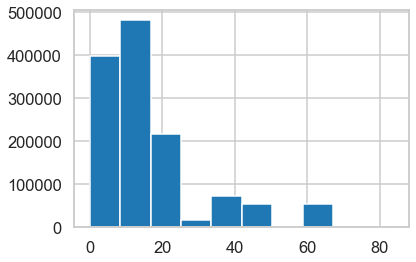

In [362]:
plt.hist(data_previous.CNT_PAYMENT)
plt.show()

#### when we replace the null values in AMT_GOODS_PRICE the most values are spread across the median value.so replace it with median

In [363]:
data_previous.CNT_PAYMENT.fillna(data_previous.CNT_PAYMENT.isnull().median(),inplace=True)

In [364]:
data_previous.isnull().mean()* 100

SK_ID_PREV                      0.000000
SK_ID_CURR                      0.000000
NAME_CONTRACT_TYPE              0.000000
AMT_ANNUITY                     0.000000
AMT_APPLICATION                 0.000000
AMT_CREDIT                      0.000060
AMT_GOODS_PRICE                 0.000000
WEEKDAY_APPR_PROCESS_START      0.000000
HOUR_APPR_PROCESS_START         0.000000
FLAG_LAST_APPL_PER_CONTRACT     0.000000
NFLAG_LAST_APPL_IN_DAY          0.000000
NAME_CASH_LOAN_PURPOSE          0.000000
NAME_CONTRACT_STATUS            0.000000
DAYS_DECISION                   0.000000
NAME_PAYMENT_TYPE               0.000000
CODE_REJECT_REASON              0.000000
NAME_CLIENT_TYPE                0.000000
NAME_GOODS_CATEGORY             0.000000
NAME_PORTFOLIO                  0.000000
NAME_PRODUCT_TYPE               0.000000
CHANNEL_TYPE                    0.000000
SELLERPLACE_AREA                0.000000
NAME_SELLER_INDUSTRY            0.000000
CNT_PAYMENT                     0.000000
NAME_YIELD_GROUP

In [365]:
data_previous.PRODUCT_COMBINATION.value_counts()

Cash                              285990
POS household with interest       263622
POS mobile with interest          220670
Cash X-Sell: middle               143883
Cash X-Sell: low                  130248
Card Street                       112582
POS industry with interest         98833
POS household without interest     82908
Card X-Sell                        80582
Cash Street: high                  59639
Cash X-Sell: high                  59301
Cash Street: middle                34658
Cash Street: low                   33834
POS mobile without interest        24082
POS other with interest            23879
POS industry without interest      12602
POS others without interest         2555
Name: PRODUCT_COMBINATION, dtype: int64

In [366]:
data_previous.PRODUCT_COMBINATION.mode()

0    Cash
dtype: object

In [367]:
data_previous.PRODUCT_COMBINATION.mode()[0]

'Cash'

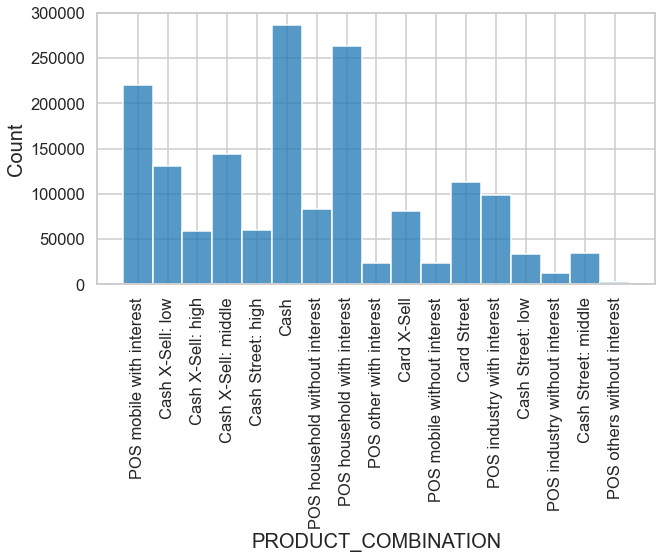

In [368]:
plt.figure(figsize=(10,5))
sns.histplot(data_previous.PRODUCT_COMBINATION)
plt.xticks(rotation=90)
plt.show()


#### In PRODUCT_COMBINATION column mode value is "cash".So we can replace it with

In [369]:
data_previous.PRODUCT_COMBINATION.fillna(data_previous.PRODUCT_COMBINATION.mode()[0],inplace=True)

In [370]:
# RECHECKING THE WHETHER THE CASH VALUES IS INCREASED OR NOT


data_previous.PRODUCT_COMBINATION.value_counts()

Cash                              286336
POS household with interest       263622
POS mobile with interest          220670
Cash X-Sell: middle               143883
Cash X-Sell: low                  130248
Card Street                       112582
POS industry with interest         98833
POS household without interest     82908
Card X-Sell                        80582
Cash Street: high                  59639
Cash X-Sell: high                  59301
Cash Street: middle                34658
Cash Street: low                   33834
POS mobile without interest        24082
POS other with interest            23879
POS industry without interest      12602
POS others without interest         2555
Name: PRODUCT_COMBINATION, dtype: int64

#### Checking DAYS_FIRST_DRAWING column

In [371]:
data_previous.DAYS_FIRST_DRAWING.head(10)

0    365243.0
1    365243.0
2    365243.0
3    365243.0
4         NaN
5    365243.0
6         NaN
7         NaN
8         NaN
9         NaN
Name: DAYS_FIRST_DRAWING, dtype: float64

In [372]:
data_previous.DAYS_FIRST_DRAWING.value_counts()

 365243.0    934444
-228.0          123
-224.0          121
-212.0          121
-223.0          119
-220.0          118
-210.0          117
-235.0          117
-240.0          116
-226.0          115
-227.0          115
-244.0          114
-217.0          112
-239.0          111
-255.0          110
-249.0          109
-197.0          109
-241.0          108
-202.0          108
-196.0          108
-237.0          108
-263.0          108
-266.0          107
-238.0          107
-256.0          106
-215.0          106
-230.0          106
-259.0          106
-252.0          106
-280.0          105
-209.0          105
-284.0          105
-222.0          105
-201.0          104
-243.0          102
-250.0          102
-192.0          102
-211.0          102
-245.0          101
-214.0          101
-200.0          101
-194.0          101
-204.0          100
-291.0          100
-189.0           99
-276.0           99
-251.0           99
-270.0           99
-236.0           99
-262.0           98


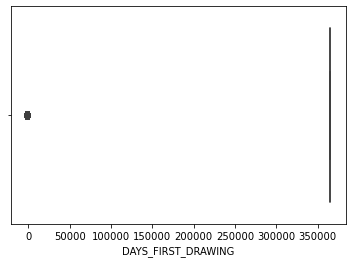

In [66]:
sns.boxplot(data_previous.DAYS_FIRST_DRAWING)  # It does not make any sense
plt.show()

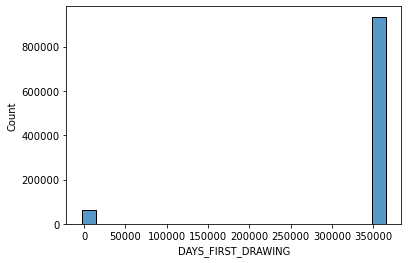

In [67]:
sns.histplot(data_previous.DAYS_FIRST_DRAWING)  
plt.show()

In [68]:
data_previous.DAYS_FIRST_DRAWING.describe()

count    997149.000000
mean     342209.855039
std       88916.115834
min       -2922.000000
25%      365243.000000
50%      365243.000000
75%      365243.000000
max      365243.000000
Name: DAYS_FIRST_DRAWING, dtype: float64

In [69]:
data_previous.DAYS_FIRST_DRAWING.mean()

342209.85503871535

In [70]:
data_previous.DAYS_FIRST_DRAWING.median()

365243.0

In [71]:
data_previous.DAYS_FIRST_DRAWING.mode()

0    365243.0
dtype: float64

#### Checking DAYS_FIRST_DUE colummn

In [72]:
data_previous.DAYS_FIRST_DUE.value_counts()

 365243.0    40645
-334.0         772
-509.0         760
-208.0         751
-330.0         750
-292.0         746
-691.0         745
-270.0         744
-299.0         744
-327.0         743
-320.0         741
-264.0         738
-313.0         737
-328.0         733
-698.0         731
-488.0         730
-271.0         730
-508.0         729
-298.0         726
-329.0         724
-322.0         715
-333.0         714
-325.0         708
-326.0         707
-361.0         706
-265.0         705
-418.0         705
-324.0         703
-257.0         703
-242.0         701
-240.0         697
-516.0         696
-390.0         695
-342.0         694
-335.0         690
-600.0         690
-243.0         689
-453.0         688
-337.0         685
-209.0         685
-340.0         683
-482.0         683
-478.0         682
-201.0         682
-300.0         681
-670.0         680
-384.0         680
-383.0         679
-291.0         679
-331.0         679
-480.0         678
-332.0         677
-690.0      

In [73]:
data_previous.DAYS_FIRST_DUE.describe()

count    997149.000000
mean      13826.269337
std       72444.869708
min       -2892.000000
25%       -1628.000000
50%        -831.000000
75%        -411.000000
max      365243.000000
Name: DAYS_FIRST_DUE, dtype: float64

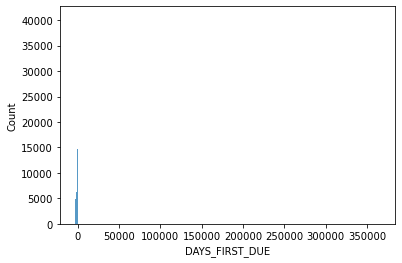

In [74]:
sns.histplot(data_previous.DAYS_FIRST_DUE)
plt.show()

<AxesSubplot:>

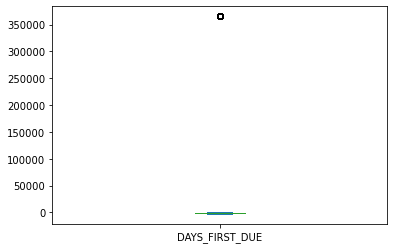

In [75]:
data_previous.DAYS_FIRST_DUE.plot.box()

In [76]:
data_previous.DAYS_FIRST_DUE.min()

-2892.0

In [77]:
data_previous.DAYS_FIRST_DUE.max()

365243.0

In [78]:
data_previous.DAYS_FIRST_DUE.mean()

13826.269336879443

In [79]:
data_previous.DAYS_FIRST_DUE.median()

-831.0

In [80]:
data_previous.DAYS_FIRST_DUE.mode()

0    365243.0
dtype: float64

#### Checking DAYS_LAST_DUE_1ST_VERSION column--

In [81]:
data_previous.DAYS_LAST_DUE_1ST_VERSION.value_counts()

 365243.0    93864
 9.0           720
 8.0           706
 0.0           705
 5.0           702
 10.0          698
 2.0           688
 6.0           685
 1.0           685
-1.0           675
-2.0           674
 3.0           672
-4.0           666
-7.0           662
 4.0           656
-12.0          656
-8.0           651
-3.0           647
 30.0          638
 11.0          636
-10.0          631
 33.0          630
 16.0          629
-6.0           624
 32.0          621
 37.0          621
 13.0          621
 17.0          619
 26.0          615
 31.0          615
 38.0          615
 19.0          614
 7.0           613
-11.0          609
-9.0           606
 12.0          602
-16.0          602
 39.0          596
 15.0          594
 29.0          594
 24.0          591
-5.0           591
 14.0          588
-21.0          587
 60.0          587
 34.0          585
 36.0          582
 28.0          582
-14.0          581
-19.0          581
 23.0          580
-23.0          580
-13.0       

In [82]:
data_previous.DAYS_LAST_DUE_1ST_VERSION.describe()

count    997149.000000
mean      33767.774054
std      106857.034789
min       -2801.000000
25%       -1242.000000
50%        -361.000000
75%         129.000000
max      365243.000000
Name: DAYS_LAST_DUE_1ST_VERSION, dtype: float64

In [83]:
data_previous.DAYS_LAST_DUE_1ST_VERSION.mean()

33767.77405382746

In [84]:
data_previous.DAYS_LAST_DUE_1ST_VERSION.median()

-361.0

In [85]:
data_previous.DAYS_LAST_DUE_1ST_VERSION.mode()

0    365243.0
dtype: float64

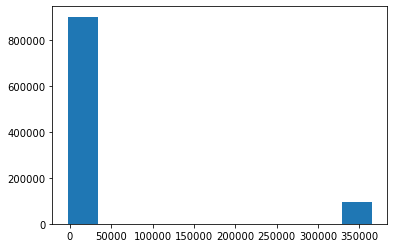

In [86]:
plt.hist(data_previous.DAYS_LAST_DUE_1ST_VERSION)
plt.show()

#### Checking DAYS_LAST_DUE column

In [87]:
data_previous.DAYS_LAST_DUE.value_counts()

 365243.0    211221
-245.0          658
-188.0          650
-239.0          642
-167.0          638
-247.0          629
-305.0          627
-268.0          624
-160.0          623
-236.0          623
-308.0          620
-240.0          620
-153.0          617
-175.0          616
-171.0          616
-174.0          616
-243.0          615
-193.0          614
-333.0          613
-181.0          613
-211.0          613
-241.0          611
-185.0          611
-223.0          611
-184.0          611
-12.0           610
-320.0          610
-192.0          610
-164.0          609
-204.0          608
-232.0          608
-202.0          608
-275.0          606
-238.0          605
-234.0          605
-207.0          605
-248.0          605
-189.0          604
-231.0          604
-284.0          604
-242.0          603
-276.0          603
-134.0          603
-92.0           602
-244.0          602
-371.0          601
-216.0          601
-271.0          601
-217.0          601
-200.0          601


In [89]:
data_previous.DAYS_LAST_DUE.describe()

count    997149.000000
mean      76582.403064
std      149647.415123
min       -2889.000000
25%       -1314.000000
50%        -537.000000
75%         -74.000000
max      365243.000000
Name: DAYS_LAST_DUE, dtype: float64

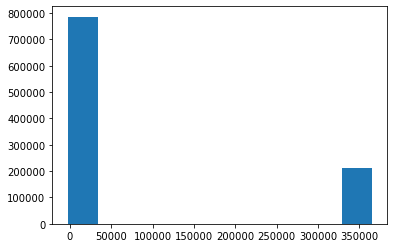

In [90]:
plt.hist(data_previous.DAYS_LAST_DUE)
plt.show()

In [91]:
data_previous.DAYS_LAST_DUE.mean()

76582.40306413585

In [92]:
data_previous.DAYS_LAST_DUE.median()

-537.0

In [93]:
data_previous.DAYS_LAST_DUE.mode()

0    365243.0
dtype: float64

In [94]:
data_previous.DAYS_LAST_DUE.quantile([0.25,0.50,0.75,0.90])

0.25     -1314.0
0.50      -537.0
0.75       -74.0
0.90    365243.0
Name: DAYS_LAST_DUE, dtype: float64

#### Checking DAYS_TERMINATION column

In [95]:
data_previous.DAYS_TERMINATION.value_counts()

 365243.0    225913
-233.0          786
-170.0          770
-184.0          770
-163.0          769
-169.0          760
-303.0          754
-177.0          753
-305.0          742
-212.0          741
-156.0          740
-142.0          738
-149.0          736
-339.0          729
-304.0          727
-162.0          727
-261.0          727
-239.0          726
-190.0          726
-218.0          726
-247.0          724
-240.0          723
-198.0          723
-164.0          722
-246.0          722
-331.0          721
-171.0          721
-225.0          720
-155.0          720
-158.0          719
-236.0          719
-274.0          718
-128.0          718
-192.0          718
-319.0          716
-275.0          716
-241.0          715
-282.0          714
-205.0          714
-107.0          714
-176.0          711
-165.0          711
-9.0            711
-219.0          710
-23.0           708
-58.0           707
-242.0          706
-214.0          706
-185.0          705
-157.0          703


In [96]:
data_previous.DAYS_TERMINATION.describe()

count    997149.000000
mean      81992.343838
std      153303.516729
min       -2874.000000
25%       -1270.000000
50%        -499.000000
75%         -44.000000
max      365243.000000
Name: DAYS_TERMINATION, dtype: float64

In [97]:
data_previous.DAYS_TERMINATION.mean()

81992.34383828295

In [98]:
data_previous.DAYS_TERMINATION.median()

-499.0

In [99]:
data_previous.DAYS_TERMINATION.mode()[0]

365243.0

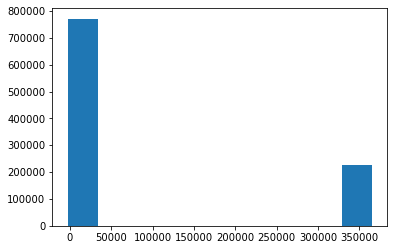

In [100]:
plt.hist(data_previous.DAYS_TERMINATION)
plt.show()

#### the columns DAYS_TERMINATION,DAYS_LAST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_FIRST_DUE,DAYS_FIRST_DRAWING makes no sense.The values are not absalute values.So it will make complication for further aanalysis. better drop these columns

In [373]:
data_previous.drop(["DAYS_TERMINATION","DAYS_LAST_DUE","DAYS_LAST_DUE_1ST_VERSION","DAYS_FIRST_DUE","DAYS_FIRST_DRAWING"],inplace=True,axis=1)

#### Checking NFLAG_INSURED_ON_APPROVAL column

In [374]:
data_previous.NFLAG_INSURED_ON_APPROVAL.describe()

count    997149.000000
mean          0.332570
std           0.471134
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max           1.000000
Name: NFLAG_INSURED_ON_APPROVAL, dtype: float64

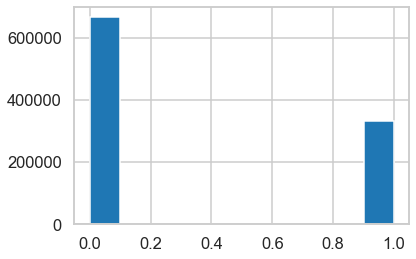

In [375]:
plt.hist(data_previous.NFLAG_INSURED_ON_APPROVAL)
plt.show()

### we can leave the null values as missing label

In [376]:
data_previous.NFLAG_INSURED_ON_APPROVAL.fillna("Missing",inplace=True)

#### Checking AMT_CREDIT column

In [377]:
data_previous.AMT_CREDIT.describe()

count    1.670213e+06
mean     1.961140e+05
std      3.185746e+05
min      0.000000e+00
25%      2.416050e+04
50%      8.054100e+04
75%      2.164185e+05
max      6.905160e+06
Name: AMT_CREDIT, dtype: float64

In [378]:
data_previous.AMT_CREDIT.value_counts()

0.000          336768
45000.000       35051
225000.000      21094
450000.000      19954
135000.000      18720
180000.000      17085
90000.000       13781
270000.000       9842
900000.000       7432
67500.000        7245
95940.000        6449
143910.000       6386
157500.000       6237
112500.000       5938
675000.000       5348
239850.000       5229
254700.000       4863
765000.000       4779
71955.000        4530
47970.000        4508
512370.000       3802
491580.000       3800
360000.000       3781
1350000.000      3763
202500.000       3761
337500.000       3672
46485.000        3577
152820.000       3464
191880.000       3316
533160.000       3313
315000.000       3218
148365.000       3044
119925.000       2816
269550.000       2653
405000.000       2611
247275.000       2597
203760.000       2505
247500.000       2480
767664.000       2445
470790.000       2421
585000.000       2358
1546020.000      2335
744498.000       2277
540000.000       2167
197820.000       2136
92970.000 

In [379]:
data_previous.AMT_CREDIT.mode()[0]

0.0

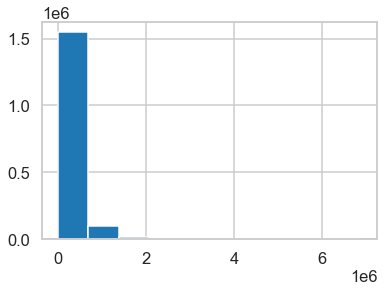

In [380]:
plt.hist(data_previous.AMT_CREDIT)
plt.show()

#### the most data spread across 0-1 distribution

In [381]:
data_previous.AMT_CREDIT.fillna(data_previous.AMT_CREDIT.mode()[0],inplace=True)

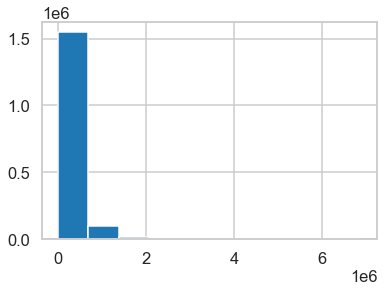

In [382]:
plt.hist(data_previous.AMT_CREDIT)
plt.show()

In [383]:
data_previous.isnull().mean()* 100

SK_ID_PREV                     0.0
SK_ID_CURR                     0.0
NAME_CONTRACT_TYPE             0.0
AMT_ANNUITY                    0.0
AMT_APPLICATION                0.0
AMT_CREDIT                     0.0
AMT_GOODS_PRICE                0.0
WEEKDAY_APPR_PROCESS_START     0.0
HOUR_APPR_PROCESS_START        0.0
FLAG_LAST_APPL_PER_CONTRACT    0.0
NFLAG_LAST_APPL_IN_DAY         0.0
NAME_CASH_LOAN_PURPOSE         0.0
NAME_CONTRACT_STATUS           0.0
DAYS_DECISION                  0.0
NAME_PAYMENT_TYPE              0.0
CODE_REJECT_REASON             0.0
NAME_CLIENT_TYPE               0.0
NAME_GOODS_CATEGORY            0.0
NAME_PORTFOLIO                 0.0
NAME_PRODUCT_TYPE              0.0
CHANNEL_TYPE                   0.0
SELLERPLACE_AREA               0.0
NAME_SELLER_INDUSTRY           0.0
CNT_PAYMENT                    0.0
NAME_YIELD_GROUP               0.0
PRODUCT_COMBINATION            0.0
NFLAG_INSURED_ON_APPROVAL      0.0
dtype: float64

### Cleaning has completed

### checking each column's datatype and values

In [384]:
data_previous.NAME_CONTRACT_TYPE.value_counts()

Cash loans         747553
Consumer loans     729151
Revolving loans    193164
XNA                   346
Name: NAME_CONTRACT_TYPE, dtype: int64

In [385]:
data_previous.NAME_CONTRACT_TYPE.dtype

dtype('O')

#### This column is unordered categorical data.it also has XNA which is not defined

In [386]:
data_previous.AMT_APPLICATION.value_counts()

0.000          392402
45000.000       47831
225000.000      43543
135000.000      40678
450000.000      38905
90000.000       29367
180000.000      24738
270000.000      20573
675000.000      20227
67500.000       16861
900000.000      15556
112500.000      14378
315000.000      11920
229500.000      10756
337500.000      10539
360000.000      10284
157500.000      10222
1350000.000      8434
202500.000       7943
247500.000       7175
454500.000       7039
1129500.000      6928
540000.000       6843
1125000.000      6390
405000.000       5876
765000.000       5109
585000.000       4763
292500.000       3786
495000.000       3749
810000.000       3487
630000.000       2868
720000.000       2753
31455.000        2569
22455.000        2545
1800000.000      2531
382500.000       2486
44955.000        2350
26955.000        2333
472500.000       2301
184500.000       2225
62955.000        2224
35955.000        2219
1354500.000      2159
679500.000       2130
2250000.000      2032
1215000.00

In [387]:
data_previous.AMT_APPLICATION.dtype

dtype('float64')

In [388]:
data_previous.AMT_CREDIT.value_counts()

0.000          336769
45000.000       35051
225000.000      21094
450000.000      19954
135000.000      18720
180000.000      17085
90000.000       13781
270000.000       9842
900000.000       7432
67500.000        7245
95940.000        6449
143910.000       6386
157500.000       6237
112500.000       5938
675000.000       5348
239850.000       5229
254700.000       4863
765000.000       4779
71955.000        4530
47970.000        4508
512370.000       3802
491580.000       3800
360000.000       3781
1350000.000      3763
202500.000       3761
337500.000       3672
46485.000        3577
152820.000       3464
191880.000       3316
533160.000       3313
315000.000       3218
148365.000       3044
119925.000       2816
269550.000       2653
405000.000       2611
247275.000       2597
203760.000       2505
247500.000       2480
767664.000       2445
470790.000       2421
585000.000       2358
1546020.000      2335
744498.000       2277
540000.000       2167
197820.000       2136
92970.000 

In [389]:
data_previous.NAME_CASH_LOAN_PURPOSE.value_counts()

XAP                                 922661
XNA                                 677918
Repairs                              23765
Other                                15608
Urgent needs                          8412
Buying a used car                     2888
Building a house or an annex          2693
Everyday expenses                     2416
Medicine                              2174
Payments on other loans               1931
Education                             1573
Journey                               1239
Purchase of electronic equipment      1061
Buying a new car                      1012
Wedding / gift / holiday               962
Buying a home                          865
Car repairs                            797
Furniture                              749
Buying a holiday home / land           533
Business development                   426
Gasification / water supply            300
Buying a garage                        136
Hobby                                   55
Money for a

In [390]:
data_previous.NAME_CASH_LOAN_PURPOSE.dtype

dtype('O')

#### the values XAP,XNA are not understandable.but it cannot removed as it is huge numbers.So leave it as it is

In [127]:
data_previous.NAME_CONTRACT_STATUS.value_counts()

Approved        1036781
Canceled         316319
Refused          290678
Unused offer      26436
Name: NAME_CONTRACT_STATUS, dtype: int64

In [128]:
data_previous.NAME_CONTRACT_STATUS.dtype

dtype('O')

In [131]:
data_previous.NAME_PAYMENT_TYPE.value_counts()

Cash through the bank                        1033552
XNA                                           627384
Non-cash from your account                      8193
Cashless from the account of the employer       1085
Name: NAME_PAYMENT_TYPE, dtype: int64

In [132]:
data_previous.CODE_REJECT_REASON.value_counts()

XAP       1353093
HC         175231
LIMIT       55680
SCO         37467
CLIENT      26436
SCOFR       12811
XNA          5244
VERIF        3535
SYSTEM        717
Name: CODE_REJECT_REASON, dtype: int64

#### Result showing XAP,XNA are some keywords using the bank it has definitely a strong meaning

In [133]:
data_previous.NAME_CLIENT_TYPE.value_counts()

Repeater     1231261
New           301363
Refreshed     135649
XNA             1941
Name: NAME_CLIENT_TYPE, dtype: int64

In [134]:
data_previous.NAME_CLIENT_TYPE.dtype

dtype('O')

####  dtype('O') means object type

In [135]:
data_previous.NAME_GOODS_CATEGORY.value_counts()

XNA                         950809
Mobile                      224708
Consumer Electronics        121576
Computers                   105769
Audio/Video                  99441
Furniture                    53656
Photo / Cinema Equipment     25021
Construction Materials       24995
Clothing and Accessories     23554
Auto Accessories              7381
Jewelry                       6290
Homewares                     5023
Medical Supplies              3843
Vehicles                      3370
Sport and Leisure             2981
Gardening                     2668
Other                         2554
Office Appliances             2333
Tourism                       1659
Medicine                      1550
Direct Sales                   446
Fitness                        209
Additional Service             128
Education                      107
Weapon                          77
Insurance                       64
Animals                          1
House Construction               1
Name: NAME_GOODS_CAT

In [136]:
data_previous.NAME_PORTFOLIO.value_counts()

POS      691011
Cash     461563
XNA      372230
Cards    144985
Cars        425
Name: NAME_PORTFOLIO, dtype: int64

In [140]:
data_previous.CHANNEL_TYPE.value_counts()

Credit and cash offices       719968
Country-wide                  494690
Stone                         212083
Regional / Local              108528
Contact center                 71297
AP+ (Cash loan)                57046
Channel of corporate sales      6150
Car dealer                       452
Name: CHANNEL_TYPE, dtype: int64

In [141]:
data_previous.NAME_YIELD_GROUP.value_counts()

XNA           517215
middle        385532
high          353331
low_normal    322095
low_action     92041
Name: NAME_YIELD_GROUP, dtype: int64

In [142]:
data_previous.PRODUCT_COMBINATION.value_counts()

Cash                              286336
POS household with interest       263622
POS mobile with interest          220670
Cash X-Sell: middle               143883
Cash X-Sell: low                  130248
Card Street                       112582
POS industry with interest         98833
POS household without interest     82908
Card X-Sell                        80582
Cash Street: high                  59639
Cash X-Sell: high                  59301
Cash Street: middle                34658
Cash Street: low                   33834
POS mobile without interest        24082
POS other with interest            23879
POS industry without interest      12602
POS others without interest         2555
Name: PRODUCT_COMBINATION, dtype: int64

# Application data dataset

In [22]:
data=pd.read_csv("C:/Users/lenovo/Downloads/application_data (1).csv")

In [23]:
# display.max_columns used to avoid truncation and view all data

pd.set_option('display.max_columns', None)
data.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [24]:
data.info(verbose = True, null_counts = True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #    Column                        Non-Null Count   Dtype  
---   ------                        --------------   -----  
 0    SK_ID_CURR                    307511 non-null  int64  
 1    TARGET                        307511 non-null  int64  
 2    NAME_CONTRACT_TYPE            307511 non-null  object 
 3    CODE_GENDER                   307511 non-null  object 
 4    FLAG_OWN_CAR                  307511 non-null  object 
 5    FLAG_OWN_REALTY               307511 non-null  object 
 6    CNT_CHILDREN                  307511 non-null  int64  
 7    AMT_INCOME_TOTAL              307511 non-null  float64
 8    AMT_CREDIT                    307511 non-null  float64
 9    AMT_ANNUITY                   307499 non-null  float64
 10   AMT_GOODS_PRICE               307233 non-null  float64
 11   NAME_TYPE_SUITE               306219 non-null  object 
 12   NAME_INCOME_TYPE            

In [25]:
data.shape

(307511, 122)

In [30]:

pd.set_option("max_rows", None)
data.isnull().mean() *100

SK_ID_CURR                       0.000000
TARGET                           0.000000
NAME_CONTRACT_TYPE               0.000000
CODE_GENDER                      0.000000
FLAG_OWN_CAR                     0.000000
FLAG_OWN_REALTY                  0.000000
CNT_CHILDREN                     0.000000
AMT_INCOME_TOTAL                 0.000000
AMT_CREDIT                       0.000000
AMT_ANNUITY                      0.003902
AMT_GOODS_PRICE                  0.090403
NAME_TYPE_SUITE                  0.420148
NAME_INCOME_TYPE                 0.000000
NAME_EDUCATION_TYPE              0.000000
NAME_FAMILY_STATUS               0.000000
NAME_HOUSING_TYPE                0.000000
REGION_POPULATION_RELATIVE       0.000000
DAYS_BIRTH                       0.000000
DAYS_EMPLOYED                    0.000000
DAYS_REGISTRATION                0.000000
DAYS_ID_PUBLISH                  0.000000
OWN_CAR_AGE                     65.990810
FLAG_MOBIL                       0.000000
FLAG_EMP_PHONE                   0

### Drop columns with more than 40% missing values.Most of these columns related with home/apartment size like living area ,non living area etc.So its not relevant to the analysis

In [31]:
columns_to_drop=['OWN_CAR_AGE','EXT_SOURCE_1','APARTMENTS_AVG','BASEMENTAREA_AVG','YEARS_BEGINEXPLUATATION_AVG','YEARS_BUILD_AVG','COMMONAREA_AVG','ELEVATORS_AVG','ENTRANCES_AVG','FLOORSMAX_AVG','FLOORSMIN_AVG','LANDAREA_AVG','LIVINGAPARTMENTS_AVG','LIVINGAREA_AVG','NONLIVINGAPARTMENTS_AVG','NONLIVINGAREA_AVG','APARTMENTS_MODE','BASEMENTAREA_MODE','YEARS_BEGINEXPLUATATION_MODE','YEARS_BUILD_MODE','COMMONAREA_MODE','ELEVATORS_MODE','ENTRANCES_MODE','FLOORSMAX_MODE','FLOORSMIN_MODE','LANDAREA_MODE','LIVINGAPARTMENTS_MODE','LIVINGAREA_MODE','NONLIVINGAPARTMENTS_MODE','NONLIVINGAREA_MODE','APARTMENTS_MEDI','BASEMENTAREA_MEDI','YEARS_BEGINEXPLUATATION_MEDI','YEARS_BUILD_MEDI','COMMONAREA_MEDI','ELEVATORS_MEDI','ENTRANCES_MEDI','FLOORSMAX_MEDI','FLOORSMIN_MEDI','LANDAREA_MEDI','LIVINGAPARTMENTS_MEDI','LIVINGAREA_MEDI','NONLIVINGAPARTMENTS_MEDI','NONLIVINGAREA_MEDI','FONDKAPREMONT_MODE','HOUSETYPE_MODE','TOTALAREA_MODE','WALLSMATERIAL_MODE','EMERGENCYSTATE_MODE']


In [28]:
len(columns_to_drop)

49

In [33]:
data.drop(columns_to_drop,axis=1,inplace=True)

In [34]:
data.isnull().mean() *100

SK_ID_CURR                      0.000000
TARGET                          0.000000
NAME_CONTRACT_TYPE              0.000000
CODE_GENDER                     0.000000
FLAG_OWN_CAR                    0.000000
FLAG_OWN_REALTY                 0.000000
CNT_CHILDREN                    0.000000
AMT_INCOME_TOTAL                0.000000
AMT_CREDIT                      0.000000
AMT_ANNUITY                     0.003902
AMT_GOODS_PRICE                 0.090403
NAME_TYPE_SUITE                 0.420148
NAME_INCOME_TYPE                0.000000
NAME_EDUCATION_TYPE             0.000000
NAME_FAMILY_STATUS              0.000000
NAME_HOUSING_TYPE               0.000000
REGION_POPULATION_RELATIVE      0.000000
DAYS_BIRTH                      0.000000
DAYS_EMPLOYED                   0.000000
DAYS_REGISTRATION               0.000000
DAYS_ID_PUBLISH                 0.000000
FLAG_MOBIL                      0.000000
FLAG_EMP_PHONE                  0.000000
FLAG_WORK_PHONE                 0.000000
FLAG_CONT_MOBILE

# Handling missing values

#### Checking AMT_ANNUITY column

In [35]:
data.AMT_ANNUITY.describe()

count    307499.000000
mean      27108.573909
std       14493.737315
min        1615.500000
25%       16524.000000
50%       24903.000000
75%       34596.000000
max      258025.500000
Name: AMT_ANNUITY, dtype: float64

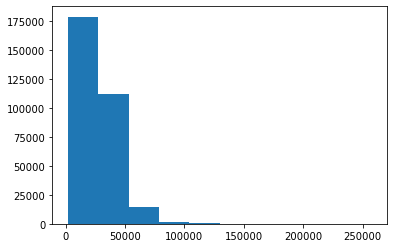

In [36]:
plt.hist(data.AMT_ANNUITY)
plt.show()

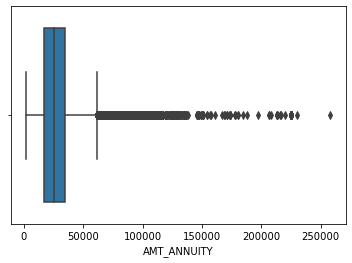

In [37]:
sns.boxplot(data.AMT_ANNUITY)
plt.show()

#### There are outliers but.the values seem to be continuous

In [38]:
data.AMT_ANNUITY.mean()

27108.573909183444

In [39]:
data.AMT_ANNUITY.median()

24903.0

In [40]:
data.AMT_ANNUITY.mode()

0    9000.0
dtype: float64

In [41]:
data.AMT_ANNUITY.isnull().sum()

12

### most values are range in between 0-50k.So mean and median values are almost same.So we can replace the missing values with mean

In [42]:
data.AMT_ANNUITY.fillna(data.AMT_ANNUITY.mean(),inplace=True)

In [43]:
data.AMT_ANNUITY.isnull().sum()

0

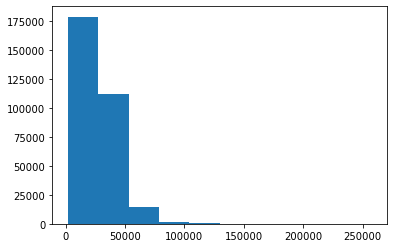

In [44]:
plt.hist(data.AMT_ANNUITY)
plt.show()

##### Checking AMT_GOODS_PRICE Column

In [45]:
data.AMT_GOODS_PRICE.isnull().sum()

278

In [46]:
data.AMT_GOODS_PRICE.describe()

count    3.072330e+05
mean     5.383962e+05
std      3.694465e+05
min      4.050000e+04
25%      2.385000e+05
50%      4.500000e+05
75%      6.795000e+05
max      4.050000e+06
Name: AMT_GOODS_PRICE, dtype: float64

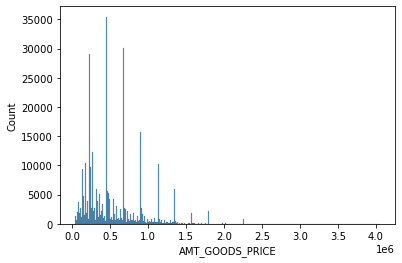

In [47]:
sns.histplot(data.AMT_GOODS_PRICE)
plt.show()

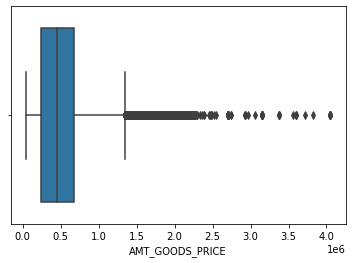

In [48]:
sns.boxplot(data.AMT_GOODS_PRICE)
plt.show()

In [49]:
data.AMT_GOODS_PRICE.mean()

538396.2074288895

In [50]:
data.AMT_GOODS_PRICE.median()

450000.0

In [51]:
data.AMT_GOODS_PRICE.quantile(.90)

1093500.0

In [52]:
data.AMT_GOODS_PRICE.min()

40500.0

In [53]:
data.AMT_GOODS_PRICE.max()

4050000.0

In [54]:
data.AMT_GOODS_PRICE.quantile([.25,.50,.75,.90])

0.25     238500.0
0.50     450000.0
0.75     679500.0
0.90    1093500.0
Name: AMT_GOODS_PRICE, dtype: float64

#### Maximum values comparitively high so we should replace null values with median

In [55]:
data.AMT_GOODS_PRICE.fillna(data.AMT_GOODS_PRICE.median(),inplace=True)

In [56]:
data.AMT_GOODS_PRICE.isnull().sum()

0

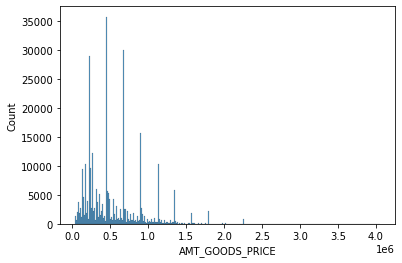

In [57]:
sns.histplot(data.AMT_GOODS_PRICE)
plt.show()

#### Checking NAME_TYPE_SUITE column 

In [249]:
data.NAME_TYPE_SUITE.value_counts(normalize=True)*100

Unaccompanied      81.159562
Family             13.111205
Spouse, partner     3.713029
Children            1.066884
Other_B             0.578018
Other_A             0.282804
Group of people     0.088499
Name: NAME_TYPE_SUITE, dtype: float64

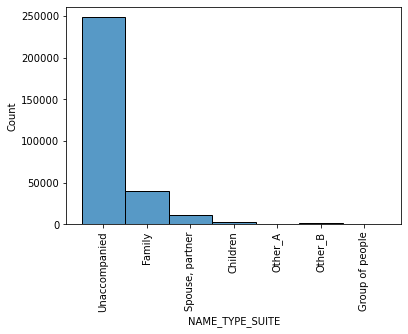

In [250]:
sns.histplot(data.NAME_TYPE_SUITE)
plt.xticks(rotation=90)
plt.show()

In [251]:
data.NAME_TYPE_SUITE.mode()[0]

'Unaccompanied'

In [252]:
data.NAME_TYPE_SUITE.isnull().sum()

1292

#### So the missing values are very small in count so we can replace it with mode value

In [58]:
data.NAME_TYPE_SUITE.fillna(data.NAME_TYPE_SUITE.mode()[0],inplace=True)

In [59]:
data.NAME_TYPE_SUITE.value_counts()

Unaccompanied      249818
Family              40149
Spouse, partner     11370
Children             3267
Other_B              1770
Other_A               866
Group of people       271
Name: NAME_TYPE_SUITE, dtype: int64

In [60]:
data.OCCUPATION_TYPE.value_counts()

Laborers                 55186
Sales staff              32102
Core staff               27570
Managers                 21371
Drivers                  18603
High skill tech staff    11380
Accountants               9813
Medicine staff            8537
Security staff            6721
Cooking staff             5946
Cleaning staff            4653
Private service staff     2652
Low-skill Laborers        2093
Waiters/barmen staff      1348
Secretaries               1305
Realty agents              751
HR staff                   563
IT staff                   526
Name: OCCUPATION_TYPE, dtype: int64

In [61]:
data.OCCUPATION_TYPE.isnull().sum()

96391

#### here null values are large so we can treat it as a missing category

In [62]:
data.OCCUPATION_TYPE.fillna("other",inplace=True)

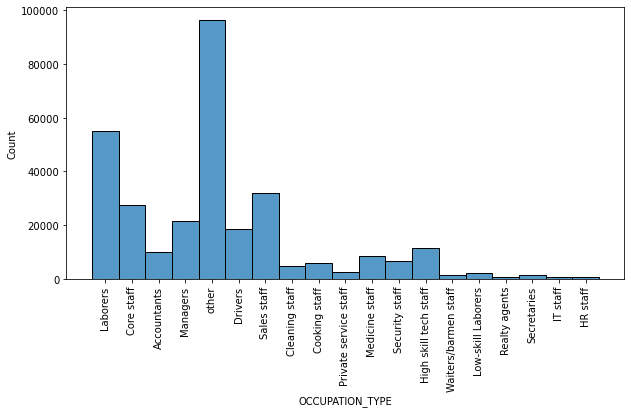

In [63]:
plt.figure(figsize=[10,5])
sns.histplot(data.OCCUPATION_TYPE)
plt.xticks(rotation=90)
plt.show()

#### Checking EXT_SOURCE_2 column

In [64]:
data.EXT_SOURCE_2.describe()

count    3.068510e+05
mean     5.143927e-01
std      1.910602e-01
min      8.173617e-08
25%      3.924574e-01
50%      5.659614e-01
75%      6.636171e-01
max      8.549997e-01
Name: EXT_SOURCE_2, dtype: float64

In [65]:
data.EXT_SOURCE_2.value_counts()

2.858979e-01    721
2.622584e-01    417
2.652563e-01    343
1.596792e-01    322
2.653117e-01    306
2.665198e-01    244
2.631436e-01    243
1.621446e-01    238
1.621921e-01    234
1.631870e-01    184
1.604053e-01    173
1.915259e-01    169
2.453496e-01    167
3.542247e-01    149
1.942664e-01    140
1.923161e-01    131
3.572820e-01    129
1.942151e-01    127
1.953538e-01    123
3.551256e-01    113
3.411229e-01    110
2.556162e-01     92
3.585685e-01     90
2.930897e-01     85
2.620553e-01     84
3.441915e-01     84
3.573422e-01     81
2.547600e-01     80
3.420278e-01     73
2.961436e-01     72
2.007754e-01     71
3.442507e-01     69
1.542654e-01     67
2.290030e-01     67
2.962028e-01     67
3.454859e-01     67
2.746463e-01     66
2.598076e-01     64
2.974306e-01     64
2.629359e-01     61
3.102603e-01     61
1.548483e-01     59
2.533716e-01     59
2.650476e-01     59
2.563408e-01     58
5.806869e-01     57
2.632411e-01     56
6.019534e-01     55
1.535706e-01     55
2.015837e-01     54


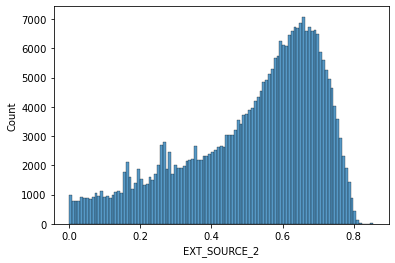

In [66]:
sns.histplot(data.EXT_SOURCE_2)
plt.show()

In [67]:
data.EXT_SOURCE_2.mean()

0.5143926741308463

In [68]:
data.EXT_SOURCE_2.median()

0.5659614260608526

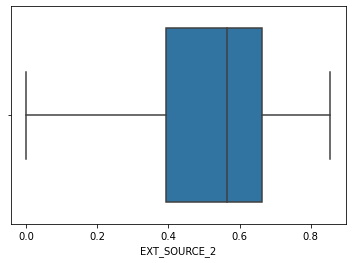

In [69]:
sns.boxplot(data.EXT_SOURCE_2)
plt.show()

In [70]:
data.EXT_SOURCE_2.isnull().sum()

660

#### EXT_SOURCE_2 column has no outilers .and also null value count is small .So we can relace the missing values with mean  value

In [71]:
data.EXT_SOURCE_2.fillna(data.EXT_SOURCE_2.mean(),inplace=True)

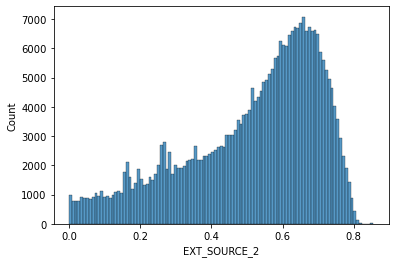

In [72]:
sns.histplot(data.EXT_SOURCE_2)
plt.show()

In [73]:
data.EXT_SOURCE_2.dtype

dtype('float64')

#### Checking  EXT_SOURCE_3 column

In [74]:
data.EXT_SOURCE_3.describe()

count    246546.000000
mean          0.510853
std           0.194844
min           0.000527
25%           0.370650
50%           0.535276
75%           0.669057
max           0.896010
Name: EXT_SOURCE_3, dtype: float64

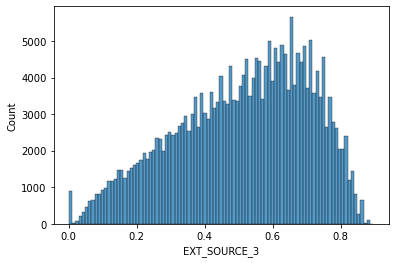

In [75]:
sns.histplot(data.EXT_SOURCE_3)
plt.show()

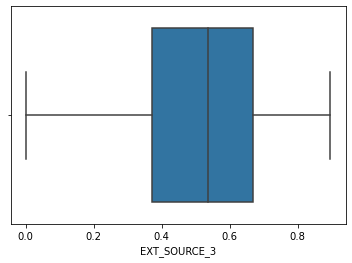

In [76]:
sns.boxplot(data.EXT_SOURCE_3)
plt.show()

In [77]:
data.EXT_SOURCE_3.mean()

0.5108529061800121

In [78]:
data.EXT_SOURCE_3.median()

0.5352762504724826

In [79]:
data.EXT_SOURCE_3.quantile(.90)

0.7490217048463391

In [80]:
data.EXT_SOURCE_3.mode()[0]

0.746300213050371

In [81]:
data.EXT_SOURCE_3.isnull().sum()

60965

### Here the column's missing value count is high.So if impute the values with mean median or mode values it may effect the whole countings.So we can leave it as it is

In [82]:
data[["OBS_30_CNT_SOCIAL_CIRCLE","DEF_30_CNT_SOCIAL_CIRCLE","OBS_60_CNT_SOCIAL_CIRCLE","DEF_60_CNT_SOCIAL_CIRCLE"]].describe()

,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE
count,306490.000000,306490.000000,306490.000000,306490.000000
mean,1.422245,0.143421,1.405292,0.100049
std,2.400989,0.446698,2.379803,0.362291
min,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000
75%,2.000000,0.000000,2.000000,0.000000
max,348.000000,34.000000,344.000000,24.000000


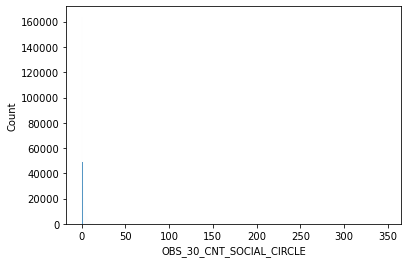

In [83]:
sns.histplot(data.OBS_30_CNT_SOCIAL_CIRCLE)
plt.show()

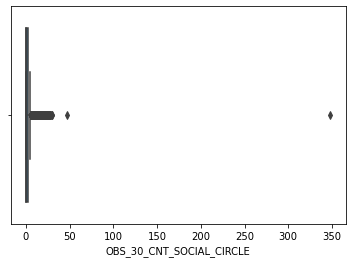

In [84]:
sns.boxplot(data.OBS_30_CNT_SOCIAL_CIRCLE)
plt.show()

In [85]:
data.OBS_30_CNT_SOCIAL_CIRCLE.isnull().sum()

1021

In [86]:
data.OBS_30_CNT_SOCIAL_CIRCLE.median()

0.0

In [87]:
data.OBS_30_CNT_SOCIAL_CIRCLE.mean()

1.4222454239942575

#### From boxplot we can see that there is an outlier .missing value count is also small.SO we can use median vlaue as impute

In [88]:
data.OBS_30_CNT_SOCIAL_CIRCLE.fillna(data.OBS_30_CNT_SOCIAL_CIRCLE.median(),inplace=True)

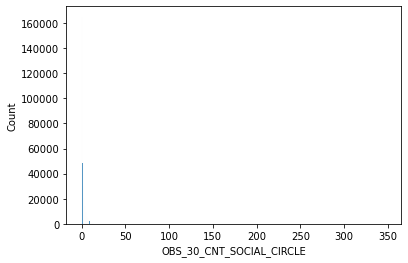

In [89]:
sns.histplot(data.OBS_30_CNT_SOCIAL_CIRCLE)
plt.show()

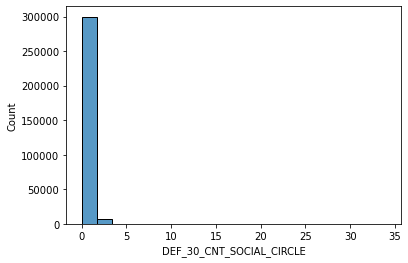

In [90]:
sns.histplot(data.DEF_30_CNT_SOCIAL_CIRCLE)
plt.show()

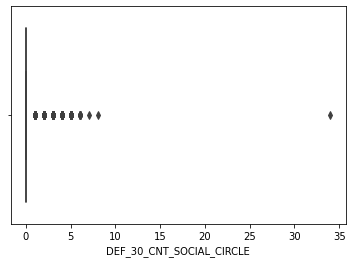

In [91]:
sns.boxplot(data.DEF_30_CNT_SOCIAL_CIRCLE)
plt.show()

In [92]:
data.DEF_30_CNT_SOCIAL_CIRCLE.mean()

0.1434206662533851

In [93]:
data.DEF_30_CNT_SOCIAL_CIRCLE.median()

0.0

In [94]:
data.DEF_30_CNT_SOCIAL_CIRCLE.mode()

0    0.0
dtype: float64

In [95]:
data.DEF_30_CNT_SOCIAL_CIRCLE.isnull().sum()

1021

#### DEF_30_CNT_SOCIAL_CIRCLE column's missing value count is small and median value can be imputed because from boxplot we can see the outlier

In [96]:
data.DEF_30_CNT_SOCIAL_CIRCLE.fillna(data.DEF_30_CNT_SOCIAL_CIRCLE.median(),inplace=True)

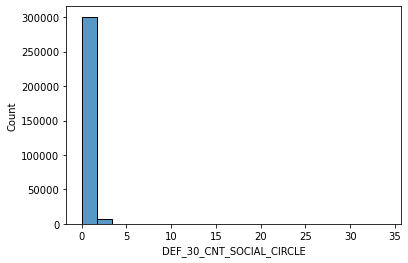

In [97]:
sns.histplot(data.DEF_30_CNT_SOCIAL_CIRCLE)
plt.show()

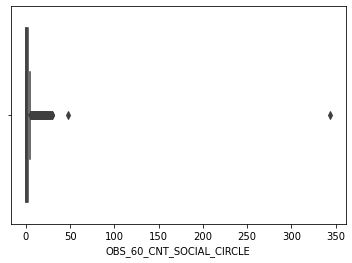

In [101]:
sns.boxplot(data.OBS_60_CNT_SOCIAL_CIRCLE)
plt.show()

In [102]:
data.OBS_60_CNT_SOCIAL_CIRCLE.mean()

1.4052921791901856

In [103]:
data.OBS_60_CNT_SOCIAL_CIRCLE.median()

0.0

### as we can see the outliers from the boxplot we can replace the missing values with median

In [104]:
data.OBS_60_CNT_SOCIAL_CIRCLE.fillna(data.OBS_60_CNT_SOCIAL_CIRCLE.median(),inplace=True)

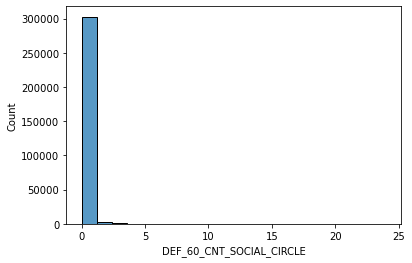

In [105]:
sns.histplot(data.DEF_60_CNT_SOCIAL_CIRCLE)
plt.show()

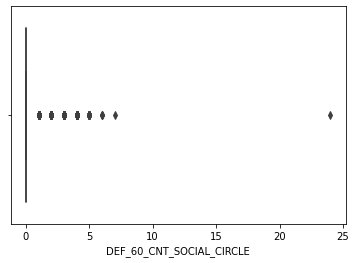

In [106]:
sns.boxplot(data.DEF_60_CNT_SOCIAL_CIRCLE)
plt.show()

In [107]:
data.DEF_60_CNT_SOCIAL_CIRCLE.mean()

0.10004894123788705

In [108]:
data.DEF_60_CNT_SOCIAL_CIRCLE.median()

0.0

#### So this column has also outiler so median value can be imputed 

In [109]:
data.DEF_60_CNT_SOCIAL_CIRCLE.fillna(data.DEF_60_CNT_SOCIAL_CIRCLE.median(),inplace=True)

### Dealing with columns having 13.501631 % missing values

In [110]:
data[["AMT_REQ_CREDIT_BUREAU_HOUR","AMT_REQ_CREDIT_BUREAU_DAY","AMT_REQ_CREDIT_BUREAU_WEEK","AMT_REQ_CREDIT_BUREAU_MON","AMT_REQ_CREDIT_BUREAU_QRT","AMT_REQ_CREDIT_BUREAU_YEAR"]].describe()

,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


In [111]:
data[["AMT_REQ_CREDIT_BUREAU_HOUR","AMT_REQ_CREDIT_BUREAU_DAY","AMT_REQ_CREDIT_BUREAU_WEEK","AMT_REQ_CREDIT_BUREAU_MON","AMT_REQ_CREDIT_BUREAU_QRT","AMT_REQ_CREDIT_BUREAU_YEAR"]].isnull().sum()

AMT_REQ_CREDIT_BUREAU_HOUR    41519
AMT_REQ_CREDIT_BUREAU_DAY     41519
AMT_REQ_CREDIT_BUREAU_WEEK    41519
AMT_REQ_CREDIT_BUREAU_MON     41519
AMT_REQ_CREDIT_BUREAU_QRT     41519
AMT_REQ_CREDIT_BUREAU_YEAR    41519
dtype: int64

In [112]:
data[["AMT_REQ_CREDIT_BUREAU_HOUR","AMT_REQ_CREDIT_BUREAU_DAY","AMT_REQ_CREDIT_BUREAU_WEEK","AMT_REQ_CREDIT_BUREAU_MON","AMT_REQ_CREDIT_BUREAU_QRT","AMT_REQ_CREDIT_BUREAU_YEAR"]].median()

AMT_REQ_CREDIT_BUREAU_HOUR    0.0
AMT_REQ_CREDIT_BUREAU_DAY     0.0
AMT_REQ_CREDIT_BUREAU_WEEK    0.0
AMT_REQ_CREDIT_BUREAU_MON     0.0
AMT_REQ_CREDIT_BUREAU_QRT     0.0
AMT_REQ_CREDIT_BUREAU_YEAR    1.0
dtype: float64

In [113]:
data.shape

(307511, 73)

# For these columns
1 we cant replace/impute the missing values as the number of missing value counts are large.
2 mean and median are not same so when we impute the value it will make huge difference in values
3 It is better leave itas it is

#### Checking CNT_FAM_MEMBERS columns

In [114]:
data.CNT_FAM_MEMBERS.value_counts()

2.0     158357
1.0      67847
3.0      52601
4.0      24697
5.0       3478
6.0        408
7.0         81
8.0         20
9.0          6
10.0         3
14.0         2
12.0         2
20.0         2
16.0         2
13.0         1
15.0         1
11.0         1
Name: CNT_FAM_MEMBERS, dtype: int64

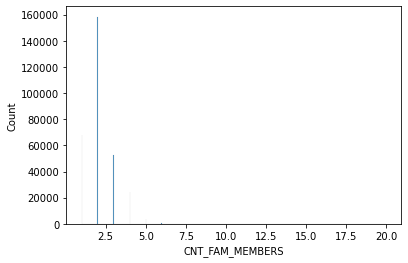

In [115]:
sns.histplot(data.CNT_FAM_MEMBERS)
plt.show()

In [116]:
data.CNT_FAM_MEMBERS.mode()[0]

2.0

In [118]:
data.CNT_FAM_MEMBERS.isnull().sum()

2

#### CNT_FAM_MEMBERS column has 2 missing values so we can replce these vlaues with mode value

In [119]:
data.CNT_FAM_MEMBERS.fillna(data.CNT_FAM_MEMBERS.mode()[0],inplace=True)

In [120]:
data.CNT_FAM_MEMBERS.value_counts().head()

2.0    158359
1.0     67847
3.0     52601
4.0     24697
5.0      3478
Name: CNT_FAM_MEMBERS, dtype: int64

### Checking DAYS_LAST_PHONE_CHANGE column

In [121]:
data.DAYS_LAST_PHONE_CHANGE.value_counts().head()

 0.0    37672
-1.0     2812
-2.0     2318
-3.0     1763
-4.0     1285
Name: DAYS_LAST_PHONE_CHANGE, dtype: int64

In [122]:
data.DAYS_LAST_PHONE_CHANGE.isnull().sum()

1

### DAYS_LAST_PHONE_CHANGE column has a missing value so we can replace it with mode value

In [123]:
data.DAYS_LAST_PHONE_CHANGE.fillna(data.DAYS_LAST_PHONE_CHANGE.mode()[0],inplace=True)

# Univarriate analysis

In [124]:
data.isnull().mean() *100

SK_ID_CURR                      0.000000
TARGET                          0.000000
NAME_CONTRACT_TYPE              0.000000
CODE_GENDER                     0.000000
FLAG_OWN_CAR                    0.000000
FLAG_OWN_REALTY                 0.000000
CNT_CHILDREN                    0.000000
AMT_INCOME_TOTAL                0.000000
AMT_CREDIT                      0.000000
AMT_ANNUITY                     0.000000
AMT_GOODS_PRICE                 0.000000
NAME_TYPE_SUITE                 0.000000
NAME_INCOME_TYPE                0.000000
NAME_EDUCATION_TYPE             0.000000
NAME_FAMILY_STATUS              0.000000
NAME_HOUSING_TYPE               0.000000
REGION_POPULATION_RELATIVE      0.000000
DAYS_BIRTH                      0.000000
DAYS_EMPLOYED                   0.000000
DAYS_REGISTRATION               0.000000
DAYS_ID_PUBLISH                 0.000000
FLAG_MOBIL                      0.000000
FLAG_EMP_PHONE                  0.000000
FLAG_WORK_PHONE                 0.000000
FLAG_CONT_MOBILE

In [125]:
# Analysisng Name contract column


data.NAME_CONTRACT_TYPE.value_counts()

Cash loans         278232
Revolving loans     29279
Name: NAME_CONTRACT_TYPE, dtype: int64

<AxesSubplot:ylabel='NAME_CONTRACT_TYPE'>

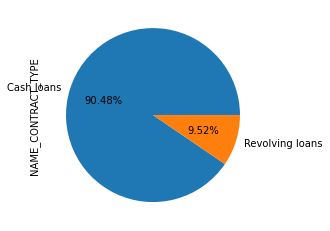

In [126]:
data.NAME_CONTRACT_TYPE.value_counts(normalize=True).plot.pie(autopct='%1.2f%%')

##### most of the loan type is cash loans.

In [127]:



data.NAME_CONTRACT_TYPE.dtype

dtype('O')

In [129]:
# Analysisng gender column

data.CODE_GENDER.value_counts()

F      202448
M      105059
XNA         4
Name: CODE_GENDER, dtype: int64

In [130]:
data.CODE_GENDER=data.CODE_GENDER.apply(lambda x:"F" if x=="XNA" else x)

<AxesSubplot:ylabel='CODE_GENDER'>

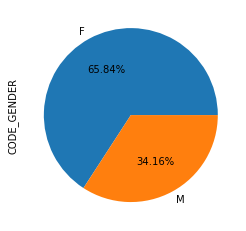

In [131]:
data.CODE_GENDER.value_counts().plot.pie(autopct='%1.2f%%')

<AxesSubplot:>

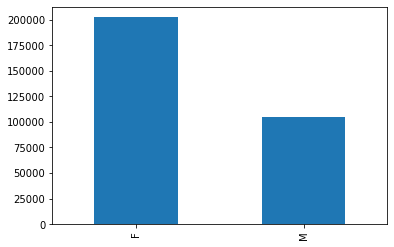

In [132]:
data.CODE_GENDER.value_counts().plot.bar()

# NOTES

1.Female customers are large in counts.
2.unordered categorical data

In [133]:
# Analysisng flag own car column

data.FLAG_OWN_CAR.value_counts()

N    202924
Y    104587
Name: FLAG_OWN_CAR, dtype: int64

<AxesSubplot:ylabel='FLAG_OWN_CAR'>

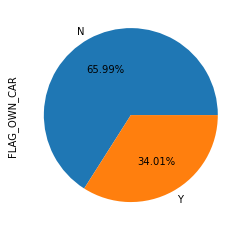

In [134]:
data.FLAG_OWN_CAR.value_counts().plot.pie(autopct='%1.2f%%')

# Notes

1.65.9% does not own car


2.unordered data

In [136]:
# Analysisng flag own realty column

data.FLAG_OWN_REALTY.dtype

dtype('O')

In [137]:
data.FLAG_OWN_REALTY.value_counts()

Y    213312
N     94199
Name: FLAG_OWN_REALTY, dtype: int64

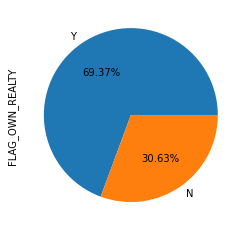

In [138]:
data.FLAG_OWN_REALTY.value_counts().plot.pie(autopct='%1.2f%%')
plt.show()

# NOTES

1.Almost 70% customers owns property like apartmnet or home

2.It is unordered categorical data

In [139]:
# Analysisng children count column


data.CNT_CHILDREN.dtype

dtype('int64')

In [140]:
data.CNT_CHILDREN.value_counts(normalize=True)*100

0     70.036844
1     19.875387
2      8.698551
3      1.208737
4      0.139507
5      0.027316
6      0.006829
7      0.002276
14     0.000976
8      0.000650
9      0.000650
12     0.000650
10     0.000650
19     0.000650
11     0.000325
Name: CNT_CHILDREN, dtype: float64

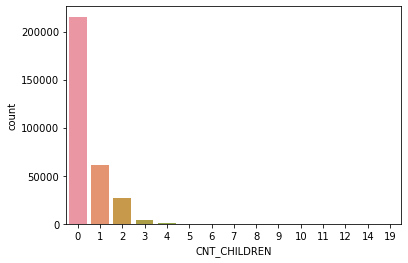

In [141]:
sns.countplot(data.CNT_CHILDREN)
plt.show()

# NOTES

1.70% of the customers have no kids

2.Categorical ordered data

3.Data type is correct as integer

In [143]:
# Analysisng education type column

data.NAME_EDUCATION_TYPE.value_counts()

Secondary / secondary special    218391
Higher education                  74863
Incomplete higher                 10277
Lower secondary                    3816
Academic degree                     164
Name: NAME_EDUCATION_TYPE, dtype: int64

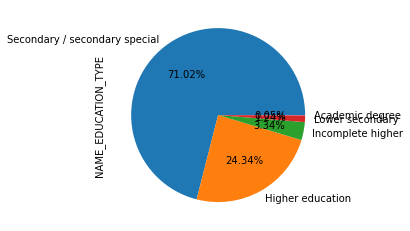

In [144]:
data.NAME_EDUCATION_TYPE.value_counts().plot.pie(autopct='%1.2f%%')
plt.show()

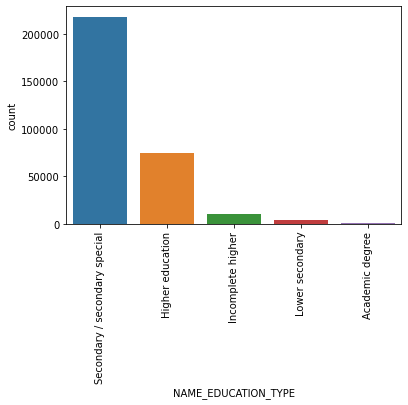

In [145]:
sns.countplot(data.NAME_EDUCATION_TYPE)
plt.xticks(rotation=90)
plt.show()

In [146]:
data.NAME_EDUCATION_TYPE.dtype

dtype('O')

# NOTES

1.Most of he cutomers are secondary /secondary special holders

2.Categorical ordered data

3.Data type typ is correct which is object

In [147]:
# Analysisng family status column

data.NAME_FAMILY_STATUS.value_counts()

Married                 196432
Single / not married     45444
Civil marriage           29775
Separated                19770
Widow                    16088
Unknown                      2
Name: NAME_FAMILY_STATUS, dtype: int64

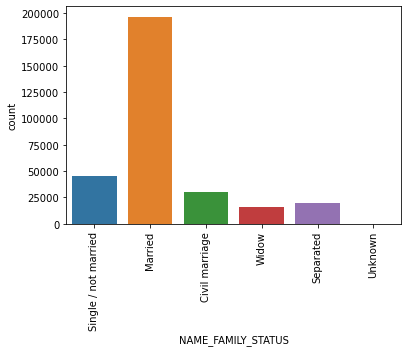

In [148]:
sns.countplot(data.NAME_FAMILY_STATUS)
plt.xticks(rotation=90)
plt.show()

# NOTES

1.Most customers are married 

2.There is a category unknown which is may be customer dont want to share or may be it is a missing value

3.we can replace the unknown to married because it is small in count

4.Categorical ordered data



In [149]:
data.NAME_FAMILY_STATUS=data.NAME_FAMILY_STATUS.apply(lambda x:"Married" if x=="Unknown" else x)

In [150]:
data.NAME_FAMILY_STATUS.value_counts()

Married                 196434
Single / not married     45444
Civil marriage           29775
Separated                19770
Widow                    16088
Name: NAME_FAMILY_STATUS, dtype: int64

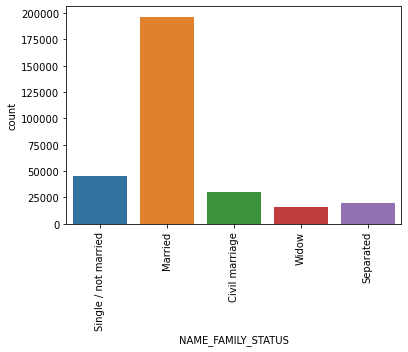

In [151]:
sns.countplot(data.NAME_FAMILY_STATUS)
plt.xticks(rotation=90)
plt.show()

#### "Unknown" category is removed

In [152]:
# Analysisng housing type column


data.NAME_HOUSING_TYPE.value_counts(normalize=True)*100

House / apartment      88.734387
With parents            4.825844
Municipal apartment     3.636618
Rented apartment        1.587260
Office apartment        0.851026
Co-op apartment         0.364865
Name: NAME_HOUSING_TYPE, dtype: float64

In [153]:
data.NAME_HOUSING_TYPE.dtype

dtype('O')

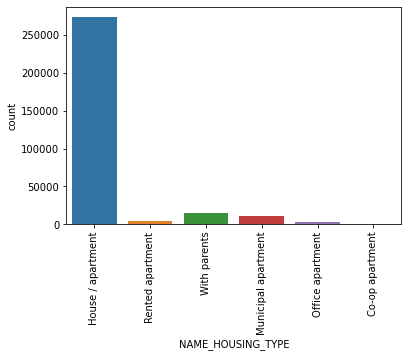

In [154]:
sns.countplot(data.NAME_HOUSING_TYPE)
plt.xticks(rotation=90)
plt.show()

# NOTES

1.Most of the customers are staying in their own house /apartment

2.data type is correct which is object

3.Categorical unordered data

In [155]:
# Analysisng region popilation column


data.REGION_POPULATION_RELATIVE.value_counts()

0.035792    16408
0.046220    13442
0.030755    12163
0.025164    11950
0.026392    11601
0.031329    11321
0.028663    11157
0.019101     8694
0.072508     8412
0.020713     8066
0.018850     7668
0.020246     7178
0.018634     7038
0.022625     6943
0.015221     6824
0.032561     6636
0.024610     6404
0.019689     6172
0.018029     6167
0.018801     6108
0.018209     6052
0.014520     4785
0.016612     4408
0.007020     4105
0.022800     3807
0.010032     3570
0.010006     3563
0.014464     3422
0.004960     3300
0.011703     3252
0.010966     3110
0.011657     3080
0.010147     3079
0.010643     3012
0.007330     2980
0.007120     2861
0.006629     2818
0.009175     2770
0.010500     2680
0.010276     2601
0.009657     2467
0.006852     2435
0.008625     2290
0.009630     2252
0.010556     2177
0.009334     2083
0.007305     2017
0.006207     1936
0.009549     1834
0.008019     1819
0.008230     1804
0.006008     1796
0.003069     1783
0.008575     1763
0.008474     1740
0.007274  

In [156]:
data.REGION_POPULATION_RELATIVE.dtype


dtype('float64')

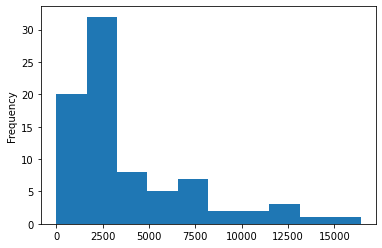

In [157]:
data.REGION_POPULATION_RELATIVE.value_counts().plot.hist()
plt.show()

# NOTES

1.We can assume most customers are coming from most populated region

2.data type is correct which is float

3.kind of nominal data

In [158]:
# Analysisng days of birth column

data.DAYS_BIRTH.value_counts()

-13749    43
-13481    42
-18248    41
-10020    41
-15771    40
-10292    40
-14267    39
-13263    39
-11664    39
-14395    39
-13891    38
-13480    38
-15565    38
-13634    38
-15042    38
-13788    38
-14791    38
-13584    38
-10136    37
-14790    37
-10107    37
-14890    37
-10192    37
-11108    37
-16257    37
-20074    37
-14767    37
-16690    37
-15048    37
-13217    37
-12806    37
-14276    37
-15563    37
-15450    37
-14386    36
-10519    36
-11524    36
-13904    36
-14926    36
-14137    36
-13643    36
-13271    36
-13706    36
-15322    36
-14776    36
-13708    36
-15009    35
-11135    35
-12776    35
-11266    35
-14120    35
-16830    35
-14099    35
-15901    35
-16185    35
-12682    35
-15073    35
-14384    35
-11588    35
-10978    35
-10088    35
-11097    35
-14825    35
-13254    35
-13687    35
-17873    35
-13922    35
-10223    35
-12433    35
-15164    35
-10123    35
-15155    35
-10213    35
-15044    35
-14350    35
-9981     35
-14297    35

# NOTES

1.These values are not providing any sense which negative values

2.so first we converted to absalute values and find the age


In [159]:
data.DAYS_BIRTH=abs(data.DAYS_BIRTH)

In [160]:
data.DAYS_BIRTH.value_counts()

13749    43
13481    42
18248    41
10020    41
15771    40
10292    40
14267    39
13263    39
11664    39
14395    39
13891    38
13480    38
15565    38
13634    38
15042    38
13788    38
14791    38
13584    38
10136    37
14790    37
10107    37
14890    37
10192    37
11108    37
16257    37
20074    37
14767    37
16690    37
15048    37
13217    37
12806    37
14276    37
15563    37
15450    37
14386    36
10519    36
11524    36
13904    36
14926    36
14137    36
13643    36
13271    36
13706    36
15322    36
14776    36
13708    36
15009    35
11135    35
12776    35
11266    35
14120    35
16830    35
14099    35
15901    35
16185    35
12682    35
15073    35
14384    35
11588    35
10978    35
10088    35
11097    35
14825    35
13254    35
13687    35
17873    35
13922    35
10223    35
12433    35
15164    35
10123    35
15155    35
10213    35
15044    35
14350    35
9981     35
14297    35
13273    35
14131    35
16490    35
16721    34
14061    34
14848    34
1035

In [161]:
data['YEARS_BIRTH'] = data['DAYS_BIRTH'].apply(lambda x: round(x/365))

In [162]:
data['YEARS_BIRTH'].value_counts()

39    9023
38    8793
37    8727
40    8602
41    8495
28    8467
32    8313
42    8308
43    8265
36    8152
44    8132
31    8021
30    7776
35    7751
33    7729
34    7659
29    7636
54    7489
45    7385
46    7333
47    7202
55    7140
53    7124
57    6926
48    6907
49    6786
52    6740
50    6696
56    6657
60    6612
59    6479
51    6417
27    6413
58    6371
61    5795
63    5467
62    5362
64    5023
26    4364
65    4318
25    4079
24    3815
23    3669
66    2641
22    1990
67    1834
68    1654
21     660
69     314
Name: YEARS_BIRTH, dtype: int64

In [163]:
data["age_bucket"]=pd.cut(data.YEARS_BIRTH,[0,30,40,50,60,9999],labels=["<30","30-40","40-50","50-60","60+"])

In [164]:
data.age_bucket.value_counts()

30-40    82770
40-50    75509
50-60    67955
<30      48869
60+      32408
Name: age_bucket, dtype: int64

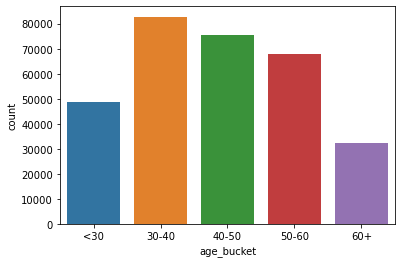

In [165]:
sns.countplot(data.age_bucket)
plt.show()

# NOTES

1.From absalute values we can find the age,then we can bucket the into different group like want to see which age group has most customers belongs

2.30-40,40-50,50-60 age groups are seems to close



In [166]:
# Analysisng employed days column


data.DAYS_EMPLOYED.value_counts()

 365243    55374
-200         156
-224         152
-230         151
-199         151
-212         150
-384         143
-229         143
-231         140
-215         138
-207         138
-216         137
-188         137
-196         136
-116         136
-222         135
-193         134
-195         133
-214         132
-254         131
-213         131
-201         130
-381         130
-233         128
-185         128
-194         127
-237         127
-184         126
-234         126
-209         125
-348         125
-241         124
-745         123
-137         123
-382         122
-139         122
-198         122
-238         122
-218         120
-240         120
-205         120
-191         120
-118         119
-223         119
-225         119
-181         118
-430         118
-244         118
-227         118
-268         117
-370         117
-133         117
-132         117
-228         117
-115         117
-119         116
-204         116
-129         116
-109         1

# NOTES

1.values are positive and negative so we should standardise the values

2.values should be positive


In [167]:
data['DAYS_EMPLOYED'] = data['DAYS_EMPLOYED'].apply(lambda x: -x if x<0 else x)

In [168]:
data.DAYS_EMPLOYED.value_counts()

365243    55374
200         156
224         152
230         151
199         151
212         150
384         143
229         143
231         140
215         138
207         138
216         137
188         137
196         136
116         136
222         135
193         134
195         133
214         132
254         131
213         131
201         130
381         130
233         128
185         128
194         127
237         127
184         126
234         126
209         125
348         125
241         124
745         123
137         123
382         122
139         122
198         122
238         122
218         120
240         120
205         120
191         120
118         119
223         119
225         119
181         118
430         118
244         118
227         118
268         117
370         117
133         117
132         117
228         117
115         117
119         116
204         116
129         116
109         115
391         115
236         115
206         115
208     

In [169]:
data.DAYS_EMPLOYED.dtype

dtype('int64')

# NOTES

1.Converted the negaive values to positives

2.Found some irregularities like 365243 as the mode value.

3.We need to sort it out whats going on

In [170]:
data[data['DAYS_EMPLOYED'] == 365243].NAME_INCOME_TYPE.value_counts()

Pensioner     55352
Unemployed       22
Name: NAME_INCOME_TYPE, dtype: int64

### we found that most DAYS_EMPLOYED belongs to pensioners and unemployed.we can convert days to years

In [171]:
data['YEARS_EMPLOYED'] = data['DAYS_EMPLOYED'].apply(lambda x: round(x/365))

In [172]:
data['YEARS_EMPLOYED'].value_counts()

1001    55374
1       34796
2       30530
3       27721
4       22933
5       19191
6       15372
7       14080
8       12381
9        9971
0        9752
10       8299
11       6483
12       5621
13       4770
14       4500
15       3916
16       2352
17       2232
18       1914
19       1851
20       1798
21       1510
22       1401
23       1100
24        950
25        862
26        727
28        656
27        638
29        567
30        512
31        439
32        390
34        355
33        352
35        300
36        207
37        174
38        128
39        122
40         82
41         66
42         44
43         31
45         27
44         20
46          7
48          4
47          2
49          1
Name: YEARS_EMPLOYED, dtype: int64

In [173]:
# Analysisng registration days column


data.DAYS_REGISTRATION.value_counts()

-1.000000        113
-7.000000         98
-6.000000         96
-4.000000         92
-2.000000         92
-5.000000         86
-3.000000         84
-9.000000         84
-14.000000        80
-21.000000        80
 0.000000         80
-10.000000        79
-11.000000        67
-511.000000       66
-15.000000        66
-8.000000         65
-56.000000        65
-23.000000        64
-41.000000        63
-621.000000       63
-13.000000        62
-70.000000        62
-34.000000        62
-69.000000        62
-19.000000        62
-20.000000        62
-742.000000       61
-812.000000       61
-29.000000        61
-735.000000       61
-679.000000       61
-389.000000       60
-569.000000       60
-827.000000       60
-342.000000       60
-42.000000        60
-4606.000000      60
-889.000000       59
-542.000000       59
-923.000000       59
-393.000000       59
-47.000000        59
-630.000000       59
-251.000000       59
-490.000000       58
-434.000000       58
-973.000000       58
-371.000000  

### The days should be positive 

In [174]:
data['DAYS_REGISTRATION'] = data['DAYS_REGISTRATION'].apply(lambda x: -x if x < 0 else x)

In [175]:
data['DAYS_REGISTRATION'].value_counts()

1.000000        113
7.000000         98
6.000000         96
4.000000         92
2.000000         92
5.000000         86
3.000000         84
9.000000         84
14.000000        80
21.000000        80
0.000000         80
10.000000        79
11.000000        67
511.000000       66
15.000000        66
8.000000         65
56.000000        65
23.000000        64
41.000000        63
621.000000       63
13.000000        62
70.000000        62
34.000000        62
69.000000        62
19.000000        62
20.000000        62
742.000000       61
812.000000       61
29.000000        61
735.000000       61
679.000000       61
389.000000       60
569.000000       60
827.000000       60
342.000000       60
42.000000        60
4606.000000      60
889.000000       59
542.000000       59
923.000000       59
393.000000       59
47.000000        59
630.000000       59
251.000000       59
490.000000       58
434.000000       58
973.000000       58
371.000000       58
736.000000       58
614.000000       58


In [176]:
data['YEARS_REGISTRATION'] = data['DAYS_REGISTRATION'].apply(lambda x: round(x/365))

In [177]:
data['YEARS_REGISTRATION'].value_counts()

1     15661
2     15564
3     13894
13    12866
12    12697
4     12002
11    11870
8     11615
14    11501
7     11478
9     10806
5     10686
10    10300
6     10272
15     9166
0      9007
17     8813
16     8397
18     8107
19     8059
20     7936
22     7606
21     7345
23     7185
24     7099
25     6655
26     6088
27     5575
28     4757
29     3809
30     3169
31     2724
32     2406
33     2225
34     2048
35     1814
36     1510
37     1238
38      905
39      675
40      506
41      394
42      294
43      233
44      162
45      112
46       66
47       61
48       32
49       30
50       22
51       12
53       12
52        8
57        7
56        7
54        6
55        3
61        3
58        3
60        2
63        2
62        1
65        1
68        1
64        1
Name: YEARS_REGISTRATION, dtype: int64

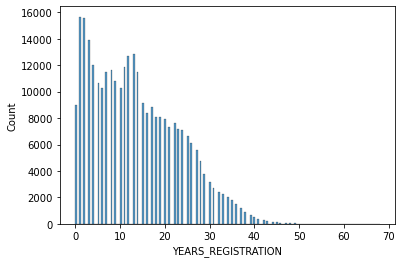

In [178]:
sns.histplot(data.YEARS_REGISTRATION)
plt.show()

# NOTES

1.Change the days to years for better understanding an analysis

2.From histplot we can see that 1 and 2 years have more values which means 1-2 years   before the application did client change his registration

In [179]:
# Analysisng days id publish column


data.DAYS_ID_PUBLISH.value_counts()

-4053    169
-4095    162
-4046    161
-4417    159
-4256    158
-4032    157
-4151    157
-4200    156
-4171    155
-4214    155
-4270    154
-4285    154
-4096    154
-4047    154
-4263    153
-4375    152
-4291    151
-4220    150
-4074    150
-4144    150
-4166    149
-4389    148
-4320    148
-4319    148
-4130    148
-4312    147
-4081    147
-4221    147
-4264    146
-4073    146
-4109    146
-4215    146
-4039    146
-4536    145
-4061    144
-4017    144
-4123    143
-4100    143
-4025    143
-4186    143
-4193    142
-4298    142
-4445    141
-4262    141
-4145    141
-4452    141
-4382    141
-4305    141
-4103    141
-4376    140
-4236    140
-4390    140
-4586    140
-4250    140
-4396    140
-4368    139
-4410    139
-4143    139
-4571    139
-4137    139
-4438    138
-4067    138
-4129    138
-4354    138
-4172    138
-4370    138
-4333    138
-4066    138
-4158    138
-4271    137
-4087    137
-4126    137
-4080    137
-4194    137
-4325    136
-4054    136
-4102    136

#### values should be positive

In [180]:
data.DAYS_ID_PUBLISH=abs(data.DAYS_ID_PUBLISH)

In [181]:
data.DAYS_ID_PUBLISH.value_counts()

4053    169
4095    162
4046    161
4417    159
4256    158
4032    157
4151    157
4200    156
4171    155
4214    155
4270    154
4285    154
4096    154
4047    154
4263    153
4375    152
4291    151
4220    150
4074    150
4144    150
4166    149
4389    148
4320    148
4319    148
4130    148
4312    147
4081    147
4221    147
4264    146
4073    146
4109    146
4215    146
4039    146
4536    145
4061    144
4017    144
4123    143
4100    143
4025    143
4186    143
4193    142
4298    142
4445    141
4262    141
4145    141
4452    141
4382    141
4305    141
4103    141
4376    140
4236    140
4390    140
4586    140
4250    140
4396    140
4368    139
4410    139
4143    139
4571    139
4137    139
4438    138
4067    138
4129    138
4354    138
4172    138
4370    138
4333    138
4066    138
4158    138
4271    137
4087    137
4126    137
4080    137
4194    137
4325    136
4054    136
4102    136
4150    136
4283    136
4369    135
4383    135
4404    135
4591    135
4284

In [182]:
data['YEARS_ID_PUBLISH'] = data['DAYS_ID_PUBLISH'].apply(lambda x: round(x/365))

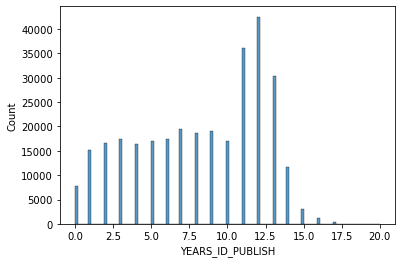

In [183]:
sns.histplot(data.YEARS_ID_PUBLISH)
plt.show()

In [184]:
data.YEARS_ID_PUBLISH.value_counts().head()

12    42521
11    36130
13    30414
7     19394
9     19089
Name: YEARS_ID_PUBLISH, dtype: int64

In [185]:
data.DAYS_ID_PUBLISH.dtype

dtype('int64')

# NOTES

1. COnveted the days into years for easiness

2.From histplot we can see that 12 years has the most values

In [186]:
# Analysisng flag mobile column

data.FLAG_MOBIL.value_counts(normalize=True)*100

1    99.999675
0     0.000325
Name: FLAG_MOBIL, dtype: float64

# NOTES

1.only one cstomer didnt provide the mobile number

In [190]:
# Analysisng occupation type column

data.OCCUPATION_TYPE.value_counts()

other                    96391
Laborers                 55186
Sales staff              32102
Core staff               27570
Managers                 21371
Drivers                  18603
High skill tech staff    11380
Accountants               9813
Medicine staff            8537
Security staff            6721
Cooking staff             5946
Cleaning staff            4653
Private service staff     2652
Low-skill Laborers        2093
Waiters/barmen staff      1348
Secretaries               1305
Realty agents              751
HR staff                   563
IT staff                   526
Name: OCCUPATION_TYPE, dtype: int64

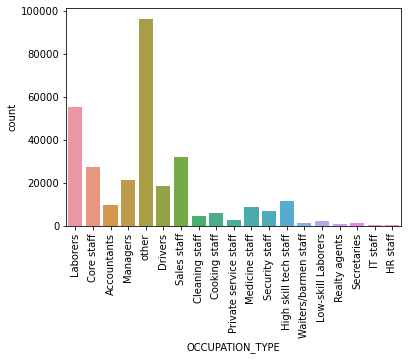

In [191]:
sns.countplot(data.OCCUPATION_TYPE)
plt.xticks(rotation=90)
plt.show()

# NOTES

1.Other category has more values which may be the customers are business or entrepernor 

2.This is categorical unordred data

In [192]:
# Analysisng family members count column

data.CNT_FAM_MEMBERS.value_counts(normalize=True)*100


2.0     51.497020
1.0     22.063276
3.0     17.105404
4.0      8.031257
5.0      1.131016
6.0      0.132678
7.0      0.026341
8.0      0.006504
9.0      0.001951
10.0     0.000976
14.0     0.000650
12.0     0.000650
20.0     0.000650
16.0     0.000650
13.0     0.000325
15.0     0.000325
11.0     0.000325
Name: CNT_FAM_MEMBERS, dtype: float64

In [193]:
data.CNT_FAM_MEMBERS.dtype

dtype('float64')

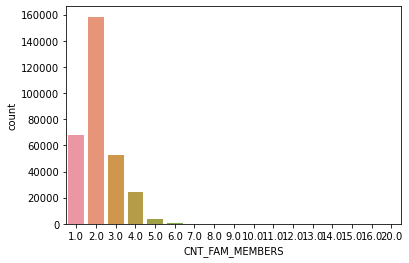

In [194]:
sns.countplot(data.CNT_FAM_MEMBERS)
plt.show()

# NOTES


1.family which has 2 family member count have most values.MAy be small family took loans for business or car loan or something.
  they have less liabilities it seems.

2. Categorical ordered data

In [196]:
# Analysisng organization type column

data.ORGANIZATION_TYPE.value_counts(normalize=True)*100

Business Entity Type 3    22.110429
XNA                       18.007161
Self-employed             12.491260
Other                      5.425172
Medicine                   3.639870
Business Entity Type 2     3.431747
Government                 3.383294
School                     2.891929
Trade: type 7              2.546576
Kindergarten               2.237318
Construction               2.185613
Business Entity Type 1     1.945947
Transport: type 4          1.755384
Trade: type 3              1.135569
Industry: type 9           1.095245
Industry: type 3           1.065978
Security                   1.055897
Housing                    0.961917
Industry: type 11          0.879318
Military                   0.856555
Bank                       0.815255
Agriculture                0.798020
Police                     0.761274
Transport: type 2          0.716722
Postal                     0.701438
Security Ministries        0.641928
Trade: type 2              0.617864
Restaurant                 0

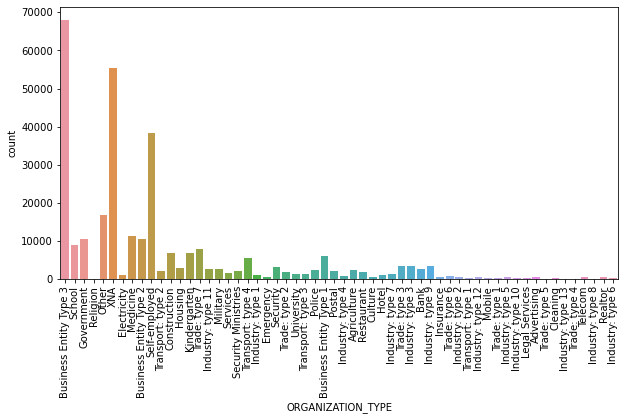

In [198]:
plt.figure(figsize=[10,5])
sns.countplot(data.ORGANIZATION_TYPE)
plt.xticks(rotation=90)
plt.show()

In [199]:
data.ORGANIZATION_TYPE.dtype

dtype('O')

# NOTES

1.Business,XNA,self employed has most values.Business ,self employed workers tends to take loans more

2.Categorical unordered data

# BIVARIATE /MULTI VARIATE ANALYSIS 

In [202]:
data.isnull().mean() *100

SK_ID_CURR                      0.000000
TARGET                          0.000000
NAME_CONTRACT_TYPE              0.000000
CODE_GENDER                     0.000000
FLAG_OWN_CAR                    0.000000
FLAG_OWN_REALTY                 0.000000
CNT_CHILDREN                    0.000000
AMT_INCOME_TOTAL                0.000000
AMT_CREDIT                      0.000000
AMT_ANNUITY                     0.000000
AMT_GOODS_PRICE                 0.000000
NAME_TYPE_SUITE                 0.000000
NAME_INCOME_TYPE                0.000000
NAME_EDUCATION_TYPE             0.000000
NAME_FAMILY_STATUS              0.000000
NAME_HOUSING_TYPE               0.000000
REGION_POPULATION_RELATIVE      0.000000
DAYS_BIRTH                      0.000000
DAYS_EMPLOYED                   0.000000
DAYS_REGISTRATION               0.000000
DAYS_ID_PUBLISH                 0.000000
FLAG_MOBIL                      0.000000
FLAG_EMP_PHONE                  0.000000
FLAG_WORK_PHONE                 0.000000
FLAG_CONT_MOBILE

In [203]:
# CREATING BINS FOR INCOME AMOUNT TOTAL

data["AMT_INCOME_TOTAL"]=pd.cut(data.AMT_INCOME_TOTAL,bins=[0,25000,50000,75000,100000,125000,150000,175000,200000,225000,250000,275000,300000,325000,350000,375000,400000,425000,450000,475000,500000,1000000],labels=['0-25000', '25000-50000','50000-75000','75000,100000','100000-125000', '125000-150000', '150000-175000','175000-200000','200000-225000','225000-250000','250000-275000','275000-300000','300000-325000','325000-350000','350000-375000','375000-400000','400000-425000','425000-450000','450000-475000','475000-500000','500000 and above'])

In [204]:
# CREATING BUCKETS FOR CREDIT AMOUNT

data["AMT_CREDIT_BUCKET"]=pd.cut(data.AMT_CREDIT,[0,150000,200000,250000,300000,350000,400000,450000,500000,550000,600000,650000,700000,750000,800000,850000,900000,1000000000],labels=['0-150000', '150000-200000','200000-250000', '250000-300000', '300000-350000', '350000-400000','400000-450000','450000-500000','500000-550000','550000-600000','600000-650000','650000-700000','700000-750000','750000-800000','800000-850000','850000-900000','900000 and above'])

In [205]:
# WE ARE DEVIDIN THE ENTIRE DATA SET INTO TWO BASED ON THE VALUET TARGET.BEACUSE THIS TARGET COLUMN HAS IMBALANCE IN VALUES.SO WE CAN EASILY ANALYSE THE IF WE DIVIDE TE DATA SET
# THE TARGET COLUMN HAS TWO VALUE 0 (The client with payment difficulties) AND 1(All other cases)



TARGET_0 = data[data["TARGET"]==0]
TARGET_1= data[data["TARGET"]==1]

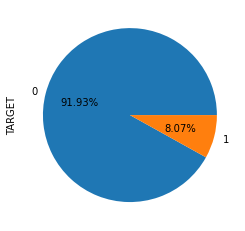

In [206]:
data.TARGET.value_counts().plot.pie(autopct='%1.2f%%')
plt.show()

# NOTES

1.Only 8.07 % of the customers are tend to become defaluter.

2.so we can try to identify patterns which indicate if a client has difficulty paying their instalments

3,so we can focus on TARGET_1 dataframe and TARGGET_0 dataframe individually 

In [207]:
TARGET_1.shape

(24825, 79)

In [208]:
TARGET_1.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,YEARS_BIRTH,age_bucket,YEARS_EMPLOYED,YEARS_REGISTRATION,YEARS_ID_PUBLISH,AMT_CREDIT_BUCKET
0,100002,1,Cash loans,M,N,Y,0,200000-225000,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,637,3648.0,2120,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,26,<30,2,10,6,400000-450000
26,100031,1,Cash loans,F,N,Y,0,100000-125000,979992.0,27076.5,702000.0,Unaccompanied,Working,Secondary / secondary special,Widow,House / apartment,0.018029,18724,2628,6573.0,1827,1,1,0,1,0,0,Cooking staff,1.0,3,2,MONDAY,9,0,0,0,0,0,0,Business Entity Type 3,0.548477,0.190706,10.0,1.0,10.0,0.0,-161.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0.0,0.0,0.0,0.0,2.0,2.0,51,50-60,7,18,5,900000 and above
40,100047,1,Cash loans,M,N,Y,0,200000-225000,1193580.0,35028.0,855000.0,Unaccompanied,Commercial associate,Secondary / secondary special,Married,House / apartment,0.025164,17482,1262,1182.0,1029,1,1,0,1,0,0,Laborers,2.0,2,2,TUESDAY,9,0,0,0,0,0,0,Business Entity Type 3,0.306841,0.320163,0.0,0.0,0.0,0.0,-1075.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,2.0,0.0,4.0,48,40-50,3,3,3,900000 and above
42,100049,1,Cash loans,F,N,N,0,125000-150000,288873.0,16258.5,238500.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.007305,13384,3597,45.0,4409,1,1,1,1,1,0,Sales staff,2.0,3,3,THURSDAY,11,0,0,0,0,0,0,Self-employed,0.674203,0.399676,1.0,0.0,1.0,0.0,-1480.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,2.0,37,30-40,10,0,12,250000-300000
81,100096,1,Cash loans,F,N,Y,0,"75000,100000",252000.0,14593.5,252000.0,Unaccompanied,Pensioner,Secondary / secondary special,Married,House / apartment,0.028663,24794,365243,5391.0,4199,1,0,0,1,0,0,other,2.0,2,2,THURSDAY,10,0,0,0,0,0,0,XNA,0.023952,0.720944,1.0,1.0,1.0,1.0,0.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,68,60+,1001,15,12,250000-300000


In [209]:
TARGET_0.shape

(282686, 79)

In [210]:
TARGET_0.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,YEARS_BIRTH,age_bucket,YEARS_EMPLOYED,YEARS_REGISTRATION,YEARS_ID_PUBLISH,AMT_CREDIT_BUCKET
1,100003,0,Cash loans,F,N,N,0,250000-275000,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186.0,291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,46,40-50,3,3,1,900000 and above
2,100004,0,Revolving loans,M,Y,Y,0,50000-75000,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,19046,225,4260.0,2531,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,52,50-60,1,12,7,0-150000
3,100006,0,Cash loans,F,N,Y,0,125000-150000,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,19005,3039,9833.0,2437,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,52,50-60,8,27,7,300000-350000
4,100007,0,Cash loans,M,N,Y,0,100000-125000,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,19932,3038,4311.0,3458,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,0.0,0.0,0.0,0.0,-1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,55,50-60,8,12,9,500000-550000
5,100008,0,Cash loans,M,N,Y,0,"75000,100000",490495.5,27517.5,454500.0,"Spouse, partner",State servant,Secondary / secondary special,Married,House / apartment,0.035792,16941,1588,4970.0,477,1,1,1,1,1,0,Laborers,2.0,2,2,WEDNESDAY,16,0,0,0,0,0,0,Other,0.354225,0.621226,0.0,0.0,0.0,0.0,-2536.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,1.0,46,40-50,4,14,1,450000-500000


In [212]:
# CREATING FUNCTION FOR PLOTTING TO REDUCE REPETITIVE

def plotfunc(df,col,title,hue =None):
    
    sns.set_style('whitegrid')
    sns.set_context('talk')
    plt.rcParams["axes.labelsize"] = 20
    plt.rcParams['axes.titlesize'] = 22
    plt.rcParams['axes.titlepad'] = 30
    
    
    temp = pd.Series(data = hue)
    fig, ax = plt.subplots()
    width = len(df[col].unique()) + 7 + 4*len(temp.unique())
    fig.set_size_inches(width , 8)
    plt.xticks(rotation=90)
    plt.yscale('log')
    plt.title(title)
    ax = sns.countplot(data = df, x= col, order=df[col].value_counts().index,hue = hue,palette='magma') 
        
    plt.show()

# Analysisng TARGET_1 dataframe 

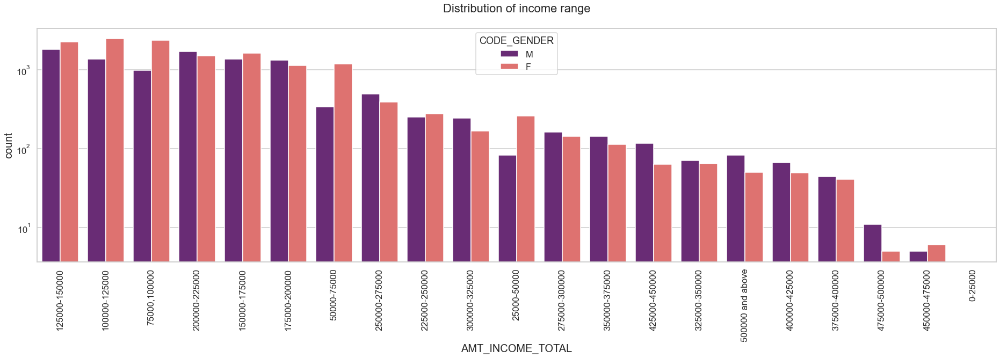

In [214]:
plotfunc(TARGET_1,col='AMT_INCOME_TOTAL',title='Distribution of income range',hue='CODE_GENDER')

# NOTES

1. Female having more income than male
2.Most values spreaded in between 100000 and 225000 and less values ranges between 

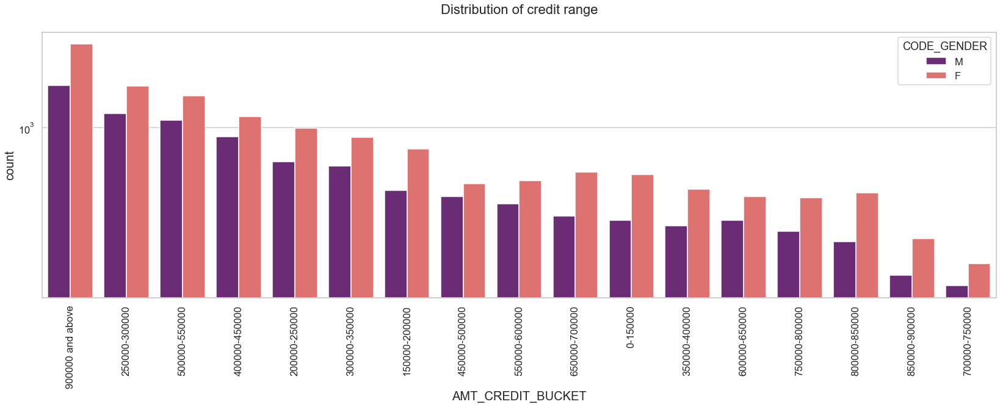

In [216]:
plotfunc(TARGET_1,col='AMT_CREDIT_BUCKET',title='Distribution of credit range',hue='CODE_GENDER')

# NOTES

1.Female customers have high value
2.The high value ranges between 900k and above 
3.less value ranges between 700k and 750k

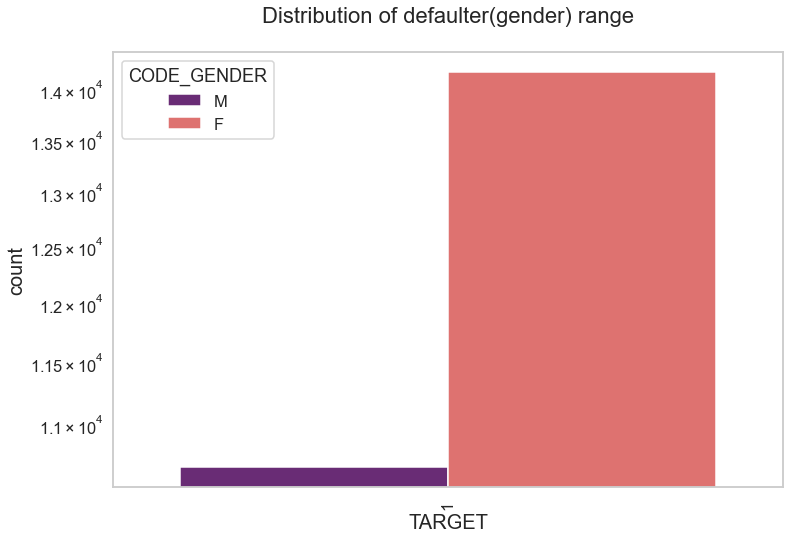

In [218]:
plotfunc(TARGET_1,col='TARGET',title='Distribution of defaulter(gender) range',hue='CODE_GENDER')

# NOTES

1.Female have more value.Female customers tends to be defaultres

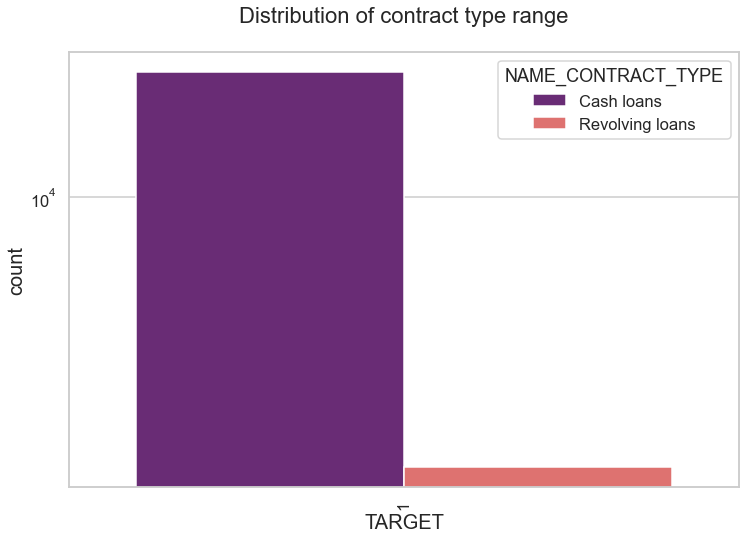

In [219]:
plotfunc(TARGET_1,col='TARGET',title='Distribution of contract type range',hue='NAME_CONTRACT_TYPE')

# NOTES

1.Cash loans have high value,i.e,customer with cash loans have a tendancy to defualter

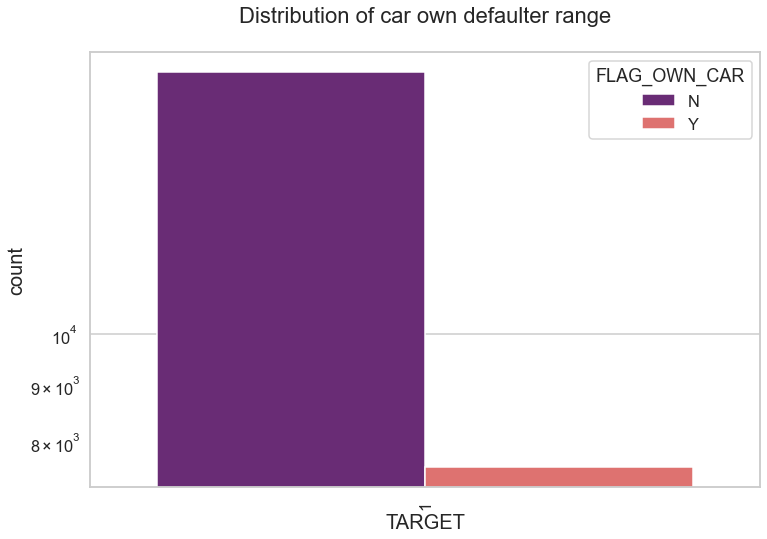

In [222]:
plotfunc(TARGET_1,col='TARGET',title='Distribution of car own defaulter range',hue='FLAG_OWN_CAR')

# NOTES

1.Customer with car owns have a less tendancy to be a defaulter

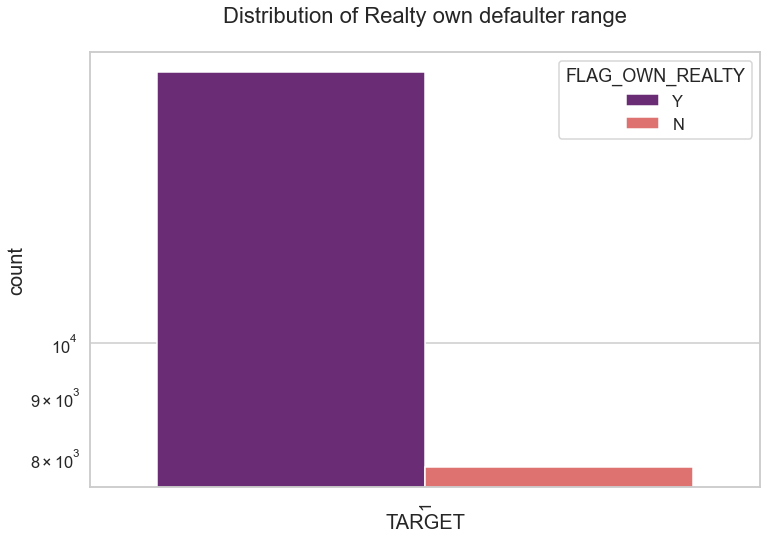

In [223]:
plotfunc(TARGET_1,col='TARGET',title='Distribution of Realty own defaulter range',hue='FLAG_OWN_REALTY')

# NOTES

1.Customer with own property have high value

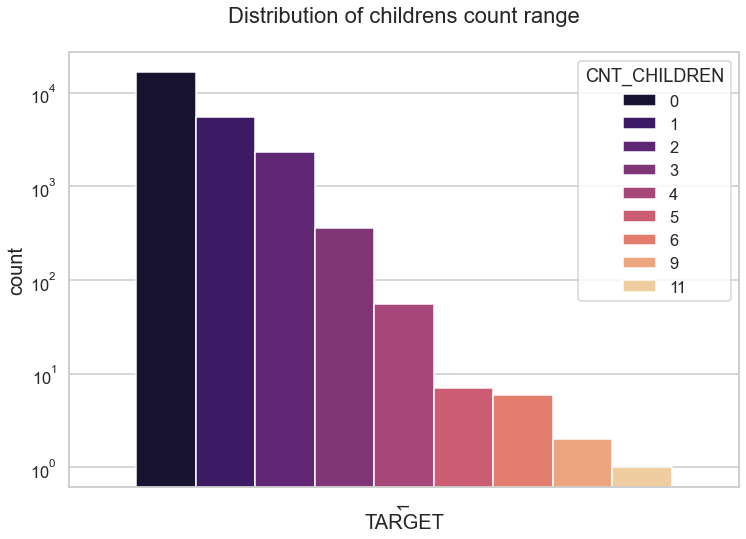

In [224]:
plotfunc(TARGET_1,col='TARGET',title='Distribution of childrens count range',hue='CNT_CHILDREN')

# NOTES

1.Customer with no children have high value and more children have less value

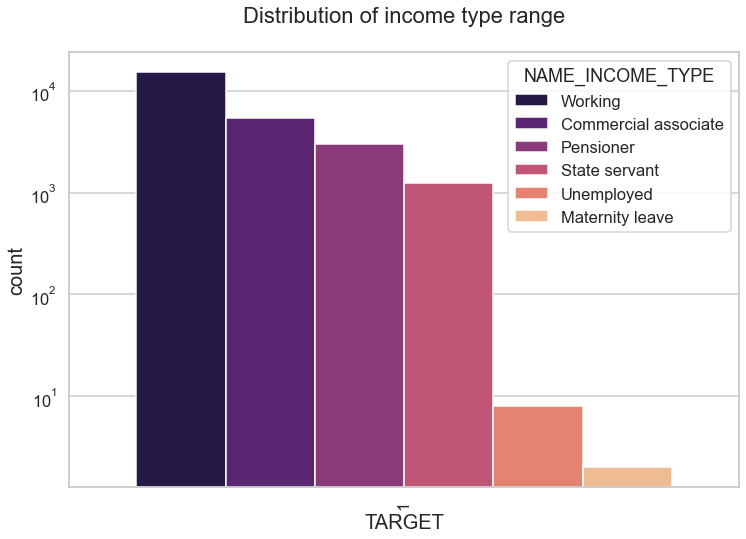

In [225]:
plotfunc(TARGET_1,col='TARGET',title='Distribution of income type range',hue='NAME_INCOME_TYPE')

#### working customers have high value 

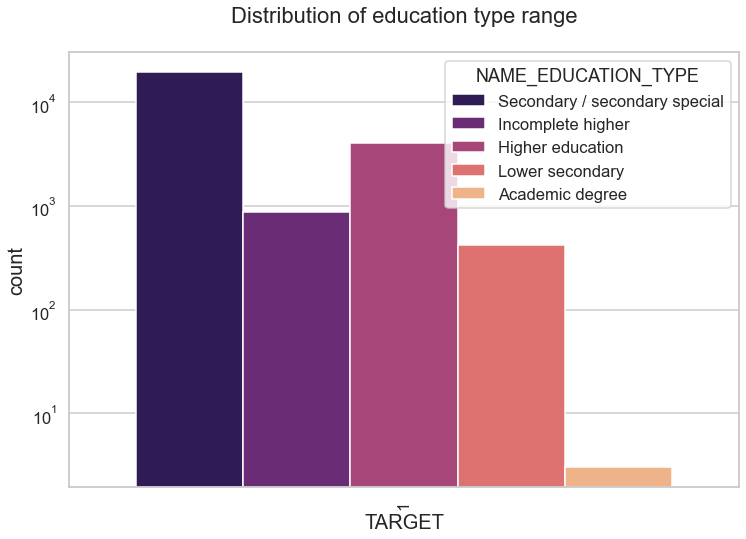

In [226]:
plotfunc(TARGET_1,col='TARGET',title='Distribution of education type range',hue='NAME_EDUCATION_TYPE')

#### secondary complete customers have high value

# Analysis of TARGET_0 dataframe

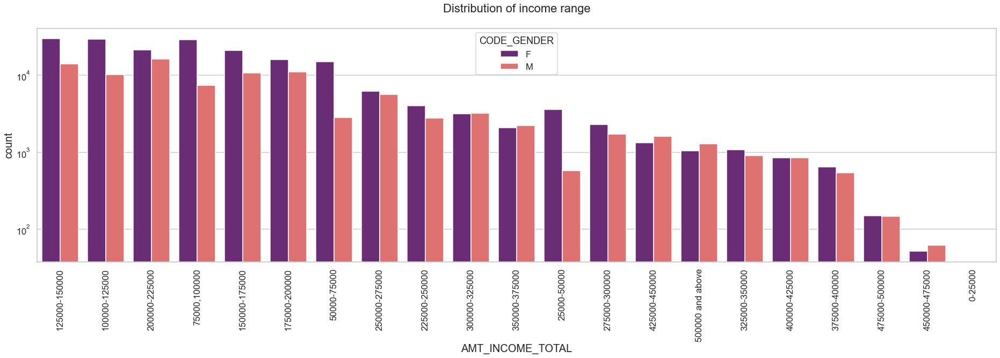

In [245]:
plotfunc(TARGET_0,col='AMT_INCOME_TOTAL',title='Distribution of income range',hue='CODE_GENDER')

# NOTES

1.Income rate 70k-150k female have tendancy to pay the loan back on time

2.Female have high payment back rate

3.less values range in between 450k-475k

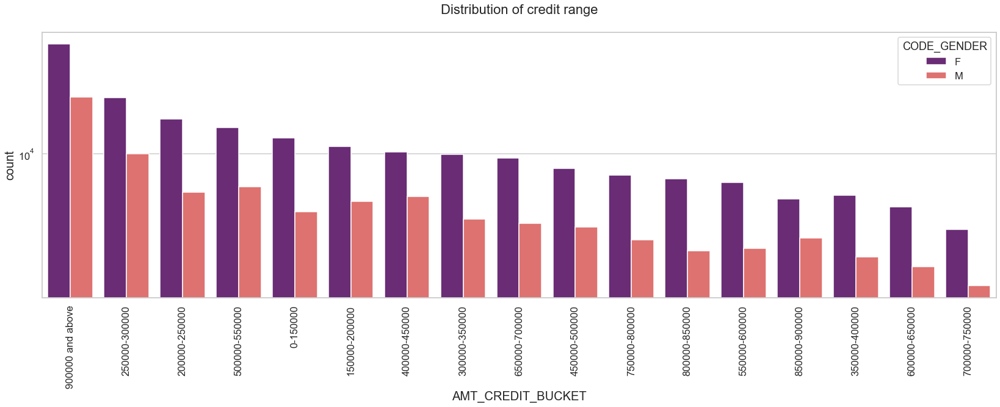

In [246]:
plotfunc(TARGET_0,col='AMT_CREDIT_BUCKET',title='Distribution of credit range',hue='CODE_GENDER')

# NOTES

1.Female have high credit amount value which is 900k and above

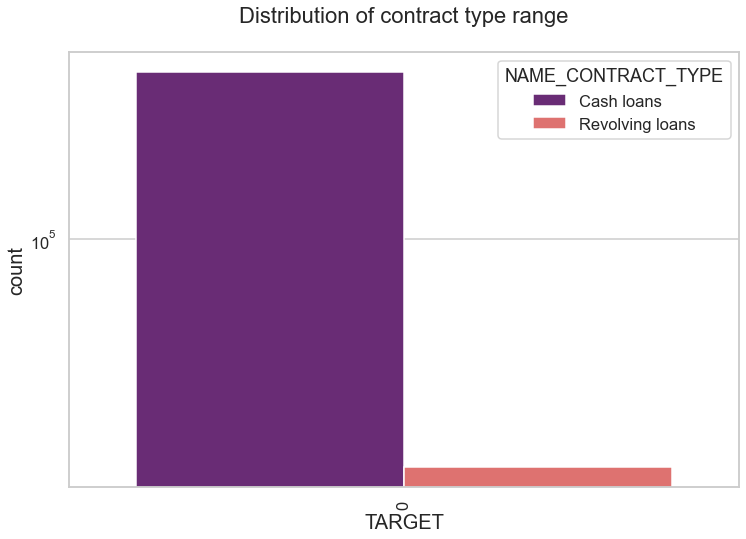

In [248]:
plotfunc(TARGET_0,col='TARGET',title='Distribution of contract type range',hue='NAME_CONTRACT_TYPE')

# NOTES

1.Cash loans customers tends to be payment back on time

# Multi variate Analysis

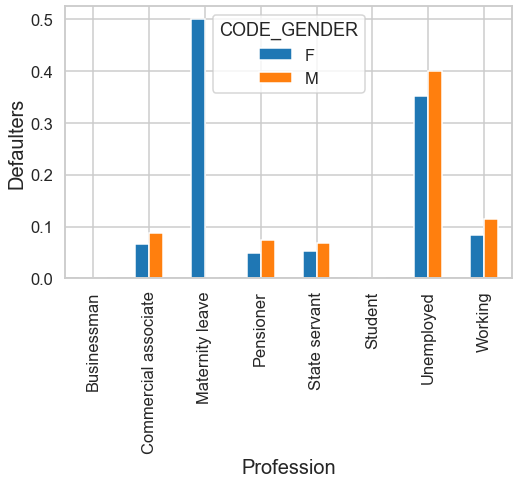

In [230]:
data.pivot_table(values='TARGET',index='NAME_INCOME_TYPE',columns='CODE_GENDER',aggfunc='mean').plot.bar(figsize=(8,5),rot=90)
plt.xlabel('Profession')
plt.ylabel('Defaulters')
plt.show()

# NOTES

1.Unemployed and females who are in maternity leave have a high tendancy to be deafulter
2.Males have high default value compared to females
3.All other profession seems to be low defaluter rate

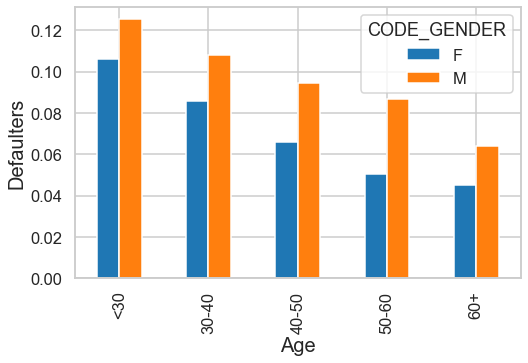

In [232]:
data.pivot_table(values='TARGET',index='age_bucket',columns='CODE_GENDER',aggfunc='mean').plot.bar(figsize=(8,5),rot=90)
plt.xlabel('Age')
plt.ylabel('Defaulters')
plt.show()

# NOTES

1.<30 age group must be students have a high default rate
2.60+ age group have less default value must be retired /pension customers

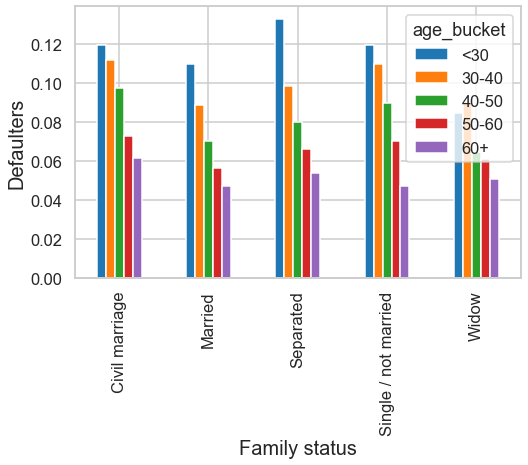

In [234]:
data.pivot_table(values='TARGET',index='NAME_FAMILY_STATUS',columns='age_bucket',aggfunc='mean').plot.bar(figsize=(8,5),rot=90)
plt.xlabel('Family status')
plt.ylabel('Defaulters')
plt.show()

# NOTES

1.<30 age group have high defaulter rate

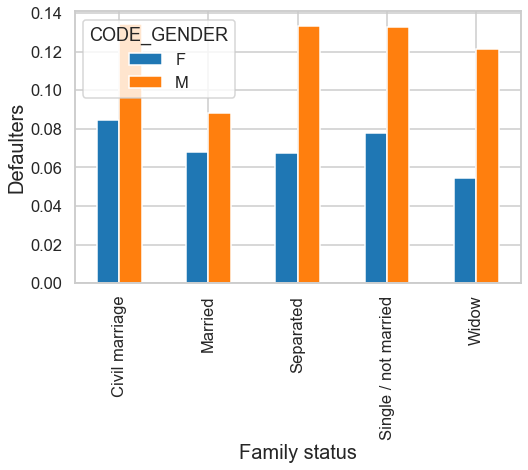

In [235]:
data.pivot_table(values='TARGET',index='NAME_FAMILY_STATUS',columns='CODE_GENDER',aggfunc='mean').plot.bar(figsize=(8,5),rot=90)
plt.xlabel('Family status')
plt.ylabel('Defaulters')
plt.show()

# NOTES

1.male customers have high default rate
2.Civil marriage have high value by compared to others

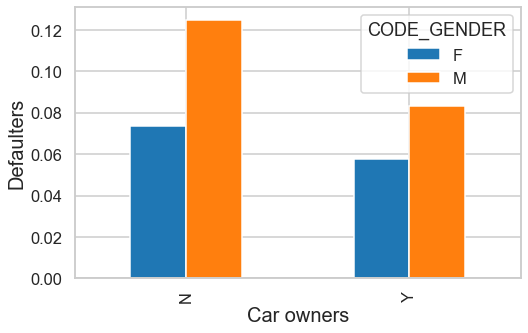

In [236]:
data.pivot_table(values='TARGET',index='FLAG_OWN_CAR',columns='CODE_GENDER',aggfunc='mean').plot.bar(figsize=(8,5),rot=90)
plt.xlabel('Car owners')
plt.ylabel('Defaulters')
plt.show()

# NOTES

1.Male values are high

2.car owners have less default rate compared to other

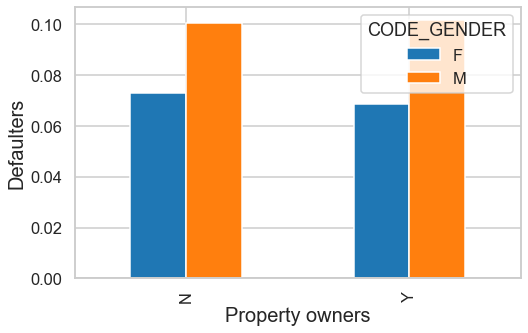

In [238]:
data.pivot_table(values='TARGET',index='FLAG_OWN_REALTY',columns='CODE_GENDER',aggfunc='mean').plot.bar(figsize=(8,5),rot=90)
plt.xlabel('Property owners')
plt.ylabel('Defaulters')
plt.show()

# NOTES

1.Both customers that property owners and other have same value

2.Male customers have high values

<Figure size 720x360 with 0 Axes>

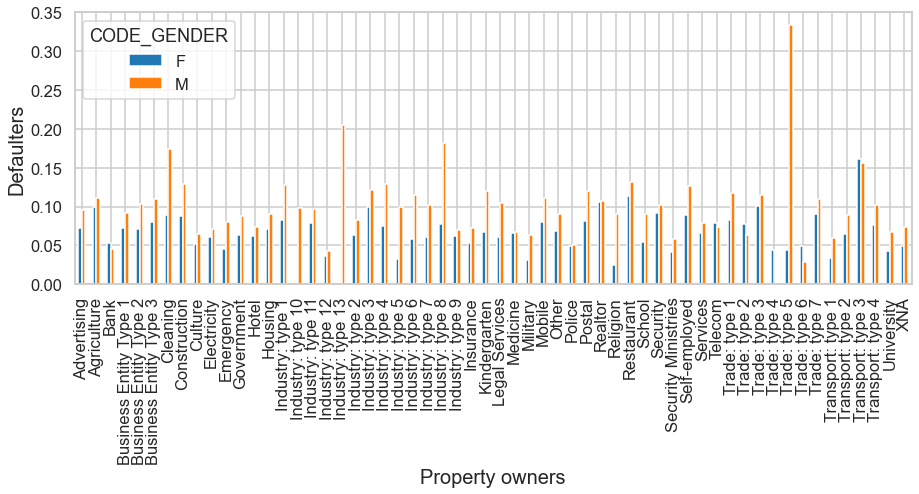

In [243]:
plt.figure(figsize=[10,5])
data.pivot_table(values='TARGET',index='ORGANIZATION_TYPE',columns='CODE_GENDER',aggfunc='mean').plot.bar(figsize=(15,5),rot=90)
plt.xlabel('Organization type')
plt.ylabel('Defaulters')
plt.show()

# NOTES

1 MAles have high default value

2.Trade type -5 organization male customers have default value

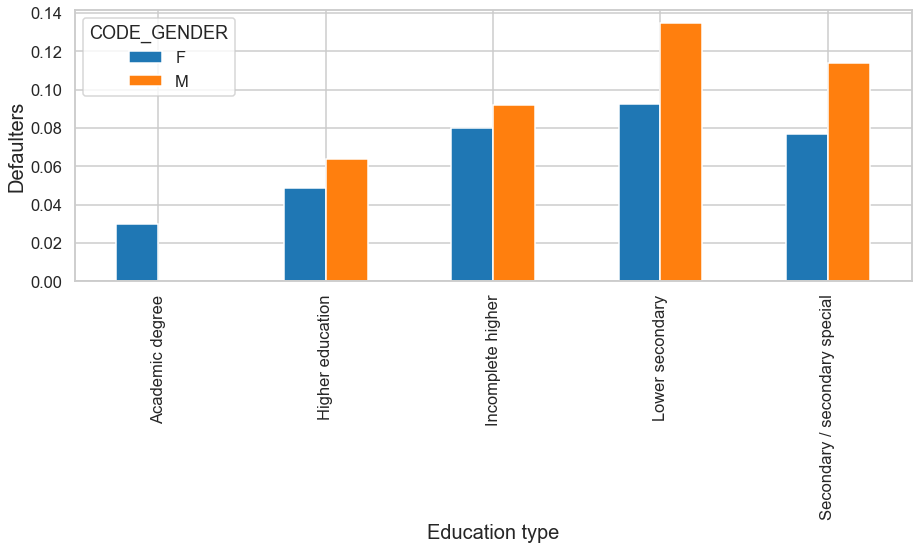

In [244]:
data.pivot_table(values='TARGET',index='NAME_EDUCATION_TYPE',columns='CODE_GENDER',aggfunc='mean').plot.bar(figsize=(15,5),rot=90)
plt.xlabel('Education type')
plt.ylabel('Defaulters')
plt.show()

# NOTES

1.Lower secodary males have high default rate
2.Academic degree females have low defult rate

# CORRELATION BET WEEN NUMERIC VALUES

In [290]:
corr_cols = ['CNT_CHILDREN','AMT_CREDIT','AMT_GOODS_PRICE','YEARS_BIRTH','AMT_INCOME_TOTAL','AMT_ANNUITY']

In [291]:
# CORRELATION BETWEEN NUMERICAL VALUES FOR DEFAULTERS
df_corr_target_1 = TARGET_1[corr_cols]
df_corr_target_1.head()

,CNT_CHILDREN,AMT_CREDIT,AMT_GOODS_PRICE,YEARS_BIRTH,AMT_INCOME_TOTAL,AMT_ANNUITY
0,0,406597.5,351000.0,26,200000-225000,24700.5
26,0,979992.0,702000.0,51,100000-125000,27076.5
40,0,1193580.0,855000.0,48,200000-225000,35028.0
42,0,288873.0,238500.0,37,125000-150000,16258.5
81,0,252000.0,252000.0,68,"75000,100000",14593.5


<AxesSubplot:>

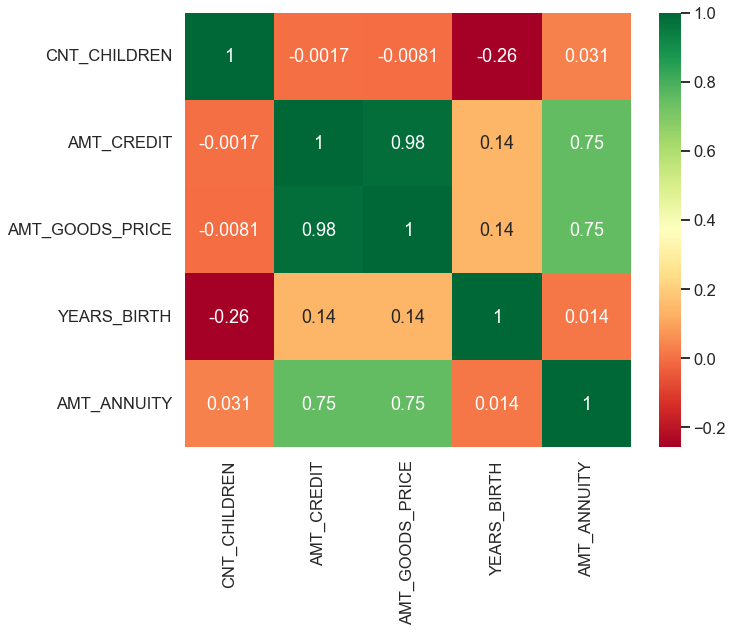

In [292]:
plt.figure(figsize=(10,8))
sns.heatmap(df_corr_target_1.corr(),cmap="RdYlGn",annot=True)
plt.show()

# NOTES

### CORRELATION BETWEEN  NUMERIC VALUES
1.AMT_CREDIT and AMT_ANNUITY (0.75)

2.AMT_CREDIT and AMT_GOODS_PRICE (0.98)

3.AMT_ANNUITY and AMT_GOODS_PRICE (0.74)

In [293]:
#CORRELATION BET WEEN NUMERICAL VALUES FOR NON DEFAULTERS

df_corr_target_0 = TARGET_0[corr_cols]
df_corr_target_0.head()

,CNT_CHILDREN,AMT_CREDIT,AMT_GOODS_PRICE,YEARS_BIRTH,AMT_INCOME_TOTAL,AMT_ANNUITY
1,0,1293502.5,1129500.0,46,250000-275000,35698.5
2,0,135000.0,135000.0,52,50000-75000,6750.0
3,0,312682.5,297000.0,52,125000-150000,29686.5
4,0,513000.0,513000.0,55,100000-125000,21865.5
5,0,490495.5,454500.0,46,"75000,100000",27517.5


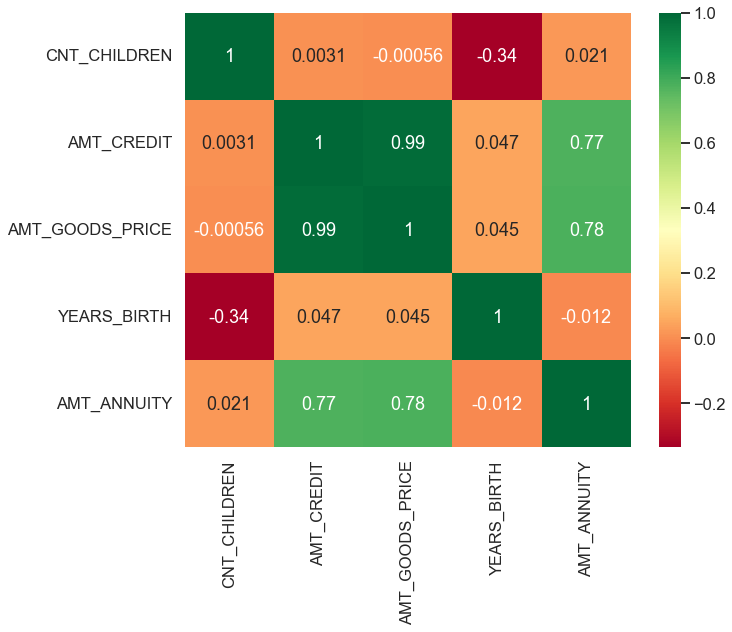

In [294]:
plt.figure(figsize=(10,8))
sns.heatmap(df_corr_target_0.corr(),cmap="RdYlGn",annot=True)
plt.show()

# NOTES

1.AMT_CREDIT and AMT_ANNUITY (0.77)
2.AMT_CREDIT and AMT_GOODS_PRICE (0.99)
3.AMT_ANNUITY and AMT_GOODS_PRICE (0.78)


##### for both defaulters and non defaulters these above values are highly correlated

# MERGING TWO DATASET

In [298]:
data_merge= pd.merge(data,data_previous, on='SK_ID_CURR', how='left')
data_merge.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE_x,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT_x,AMT_ANNUITY_x,AMT_GOODS_PRICE_x,NAME_TYPE_SUITE_x,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START_x,HOUR_APPR_PROCESS_START_x,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,YEARS_BIRTH,age_bucket,YEARS_EMPLOYED,YEARS_REGISTRATION,YEARS_ID_PUBLISH,AMT_CREDIT_BUCKET,SK_ID_PREV,NAME_CONTRACT_TYPE_y,AMT_ANNUITY_y,AMT_APPLICATION,AMT_CREDIT_y,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE_y,WEEKDAY_APPR_PROCESS_START_y,HOUR_APPR_PROCESS_START_y,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE_y,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,100002,1,Cash loans,M,N,Y,0,200000-225000,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,9461,637,3648.0,2120,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,26,<30,2,10,6,400000-450000,1038818.0,Consumer loans,9251.775,179055.0,179055.0,0.0,179055.0,SATURDAY,9.0,Y,1.0,0.000000,NaN,NaN,XAP,Approved,-606.0,XNA,XAP,NaN,New,Vehicles,POS,XNA,Stone,500.0,Auto technology,24.0,low_normal,POS other with interest,365243.0,-565.0,125.0,-25.0,-17.0,0.0
1,100003,0,Cash loans,F,N,N,0,250000-275000,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186.0,291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,46,40-50,3,3,1,900000 and above,1810518.0,Cash loans,98356.995,900000.0,1035882.0,NaN,900000.0,FRIDAY,12.0,Y,1.0,NaN,NaN,NaN,XNA,Approved,-746.0,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1.0,XNA,12.0,low_normal,Cash X-Sell: low,365243.0,-716.0,-386.0,-536.0,-527.0,1.0
2,100003,0,Cash loans,F,N,N,0,250000-275000,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,16765,1188,1186.0,291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,46,40-50,3,3,1,900000 and above,2636178.0,Consumer loans,64567.665,337500.0,348637.5,0.0,337500.0,SUNDAY,17.0,Y,1.0,0.000000,NaN,NaN,XAP,Approved,-828.0,Cash through the bank,XAP,Family,Refreshed,Furniture,POS,XNA,Stone,1400.0,Furniture,6.0,middle,POS

In [299]:
data_merge.shape

(1430155, 115)

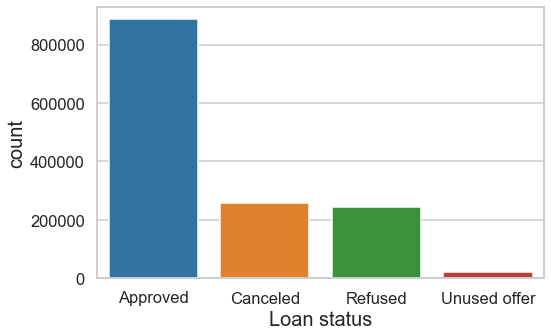

In [301]:
plt.figure(figsize=(8,5))   
ax = sns.countplot(x = 'NAME_CONTRACT_STATUS',data=data_merge)
ax.set(xlabel='Loan status')
plt.show()

### Approved>canceled>Refused>unused offer

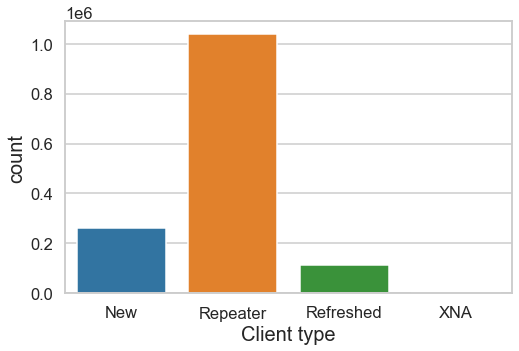

In [302]:
plt.figure(figsize=(8,5))   
ax = sns.countplot(x = 'NAME_CLIENT_TYPE',data=data_merge)
ax.set(xlabel='Client type')
plt.show()

#### Repeater has high value

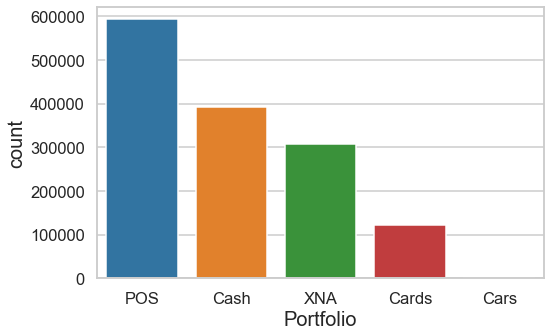

In [304]:
plt.figure(figsize=(8,5))   
ax = sns.countplot(x = 'NAME_PORTFOLIO',data=data_merge)
ax.set(xlabel='Portfolio')
plt.show()

#### POS has highest value cars have very less value


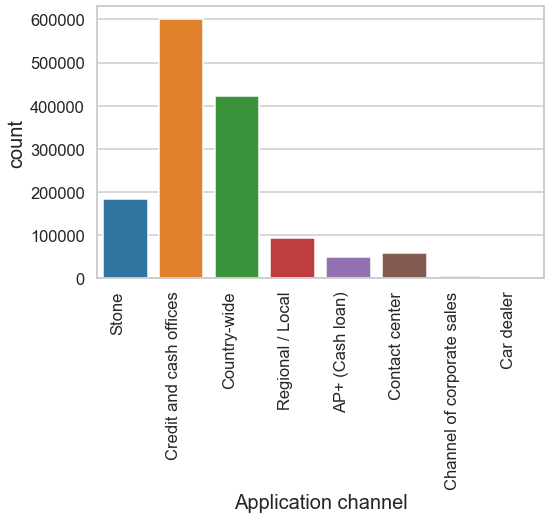

In [305]:
plt.figure(figsize=(8,5))   
ax = sns.countplot(x = 'CHANNEL_TYPE',data=data_merge)
temp = ax.set_xticklabels(ax.get_xticklabels(), rotation = 90, horizontalalignment='right')
ax.set(xlabel='Application channel')
plt.show()

#### Credit and cash offices have high value

# Conclusion



1.Banks should focus less on income type ‘Working’ as they are having most number of unsuccessful payments.

2. Also with loan purpose ‘Repair’ is having higher number of unsuccessful payments on time.

3.Female clients on maternity leave should NOT be targeted as they have no record of repayments (therefore they are highly  likely to default and targeting them would lead to a loss)

4.Clients should NOT be targeted based on their education type alone as the data is very inconclusive

5. Banks SHOULD target clients who own a car.

6. Banks SHOULD also target female clients as they are the highest repayers (almost as double as males) amongst both the genders.
